In [1]:
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import anndata as ad
import seaborn as sns
from scipy import sparse
import pymn
import itertools

In [2]:

maize_single_cell = sc.read_h5ad('/data/passala/Collaborator_Data/Maize_arabi_Jack_Collab/xu16_19_29_32_SeuratV4.0.1_finalclustermaize.h5ad')
maize_single_cell #Test annotation for my data

AnnData object with n_obs × n_vars = 10551 × 28492
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1'
    var: '_index', 'features'
    obsm: 'X_umap'

In [3]:
maize_single_cell.obsm['X_umap']

array([[-1.24868038,  2.23365191],
       [-4.71031561,  1.73476366],
       [ 1.41274533,  1.85823373],
       ...,
       [-3.27618447,  2.46618585],
       [-3.75875845,  1.31210891],
       [-5.12317315, -1.43737992]])

In [4]:
arabi_single_cell = sc.read_h5ad('/data/passala/Collaborator_Data/Maize_arabi_Jack_Collab/xu_41_42.int_filter_recluster_final_forBen_arabi.h5ad')
arabi_single_cell

AnnData object with n_obs × n_vars = 20224 × 23339
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'RNA_snn_res.0.5', 'seurat_clusters', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54'
    var: '_index', 'features'
    obsm: 'X_umap'

In [5]:
arabi_single_cell.obs['Original_Jack_Clusters'] = arabi_single_cell.obs['integrated_snn_res.0.75'].astype(str)
maize_single_cell.obs['Original_Jack_Clusters'] = maize_single_cell.obs['subcluster9'].astype(str)

In [6]:
co_expressalog_map_85 = pd.read_csv('/home/passala/Gene_duplication_project/Code/Jack_Dave_maize_project/Minor_tables/true_pair_dataframe_at_80_tolerance.csv')
ensmbl_to_grm = pd.read_csv('/home/passala/Gene_duplication_project/Code/Jack_Dave_maize_project/Minor_tables/ensmbl_to_grm_table.csv')
co_expressalog_map_85

,Arabidopsis Gene,Maize Gene
0,AT3G50620,Zm00001d029417
1,AT2G15730,Zm00001d052886
2,AT5G44040,Zm00001d027589
3,AT5G42760,Zm00001d034249
4,AT3G53470,Zm00001d031954
...,...,...
6230,AT2G35170,Zm00001d000053
6231,AT4G17540,Zm00001d000035
6232,AT4G16970,Zm00001d000034
6233,AT2G15980,Zm00001d000435


In [7]:
co_expressalog_map_85 = co_expressalog_map_85.merge(right = ensmbl_to_grm, how = 'left', left_on= 'Maize Gene', right_on= 'EnsemblID')
co_expressalog_map_85 = co_expressalog_map_85.dropna()
co_expressalog_map_85 = co_expressalog_map_85[['Arabidopsis Gene','GRM Name']]


In [8]:
co_expressalog_map_85

,Arabidopsis Gene,GRM Name
0,AT3G50620,GRMZM2G003530
1,AT2G15730,GRMZM5G877077
2,AT5G44040,GRMZM2G172758
3,AT5G42760,GRMZM2G068179
4,AT3G53470,GRMZM2G144982
...,...,...
6225,AT4G18370,GRMZM2G118646
6227,AT1G77840,EIF5
6228,AT1G71696,GRMZM2G106683
6229,AT4G27030,GRMZM2G175401


In [9]:
co_expressalog_map_85.to_csv('/home/passala/Gene_duplication_project/Code/Jack_Dave_maize_project/Minor_tables/coexpressalog_at_80_tolerance_v3_names.csv')

In [10]:
arabi_single_cell.var.index

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9',
       ...
       '23329', '23330', '23331', '23332', '23333', '23334', '23335', '23336',
       '23337', '23338'],
      dtype='object', length=23339)

In [11]:
arabi_single_cell.var = arabi_single_cell.var.merge(right = co_expressalog_map_85, right_on = 'Arabidopsis Gene', how = 'left', left_on = 'features')

arabi_single_cell.var.index = arabi_single_cell.var['features'].to_list()
arabi_single_cell.var

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .var.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


,_index,features,Arabidopsis Gene,GRM Name
AT1G01010,AT1G01010,AT1G01010,NaN,NaN
AT1G01020,AT1G01020,AT1G01020,NaN,NaN
AT1G01030,AT1G01030,AT1G01030,NaN,NaN
AT1G01040,AT1G01040,AT1G01040,NaN,NaN
AT1G01050,AT1G01050,AT1G01050,AT1G01050,GRMZM2G061928
...,...,...,...,...
AT5G67060,AT5G67060,AT5G67060,NaN,NaN
ATCG00830,ATCG00830,ATCG00830,NaN,NaN
ATCG00920,ATCG00920,ATCG00920,NaN,NaN
ATCG01000,ATCG01000,ATCG01000,NaN,NaN


In [12]:
maize_single_cell.var

,_index,features
0,GRMZM2G059865,GRMZM2G059865
1,GRMZM2G093344,GRMZM2G093344
2,GRMZM2G306216,GRMZM2G306216
3,GRMZM2G104572,GRMZM2G104572
4,GRMZM5G822187,GRMZM5G822187
...,...,...
28487,GRMZM2G128549,GRMZM2G128549
28488,GRMZM2G450231,GRMZM2G450231
28489,GRMZM2G074773,GRMZM2G074773
28490,GRMZM5G826672,GRMZM5G826672


In [13]:
co_expressalog_map_85

,Arabidopsis Gene,GRM Name
0,AT3G50620,GRMZM2G003530
1,AT2G15730,GRMZM5G877077
2,AT5G44040,GRMZM2G172758
3,AT5G42760,GRMZM2G068179
4,AT3G53470,GRMZM2G144982
...,...,...
6225,AT4G18370,GRMZM2G118646
6227,AT1G77840,EIF5
6228,AT1G71696,GRMZM2G106683
6229,AT4G27030,GRMZM2G175401


In [14]:
maize_single_cell.var

,_index,features
0,GRMZM2G059865,GRMZM2G059865
1,GRMZM2G093344,GRMZM2G093344
2,GRMZM2G306216,GRMZM2G306216
3,GRMZM2G104572,GRMZM2G104572
4,GRMZM5G822187,GRMZM5G822187
...,...,...
28487,GRMZM2G128549,GRMZM2G128549
28488,GRMZM2G450231,GRMZM2G450231
28489,GRMZM2G074773,GRMZM2G074773
28490,GRMZM5G826672,GRMZM5G826672


In [15]:
maize_single_cell.var.merge(right = co_expressalog_map_85, right_on = 'GRM Name', how = 'left', left_on = 'features')


,_index,features,Arabidopsis Gene,GRM Name
0,GRMZM2G059865,GRMZM2G059865,NaN,NaN
1,GRMZM2G093344,GRMZM2G093344,NaN,NaN
2,GRMZM2G306216,GRMZM2G306216,NaN,NaN
3,GRMZM2G104572,GRMZM2G104572,NaN,NaN
4,GRMZM5G822187,GRMZM5G822187,NaN,NaN
...,...,...,...,...
28487,GRMZM2G128549,GRMZM2G128549,NaN,NaN
28488,GRMZM2G450231,GRMZM2G450231,NaN,NaN
28489,GRMZM2G074773,GRMZM2G074773,NaN,NaN
28490,GRMZM5G826672,GRMZM5G826672,NaN,NaN


In [16]:
maize_single_cell.var = maize_single_cell.var.merge(right = co_expressalog_map_85, right_on = 'GRM Name', how = 'left', left_on = 'features')

maize_single_cell.var.index = maize_single_cell.var['features'].to_list()
maize_single_cell.var

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .var.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


,_index,features,Arabidopsis Gene,GRM Name
GRMZM2G059865,GRMZM2G059865,GRMZM2G059865,NaN,NaN
GRMZM2G093344,GRMZM2G093344,GRMZM2G093344,NaN,NaN
GRMZM2G306216,GRMZM2G306216,GRMZM2G306216,NaN,NaN
GRMZM2G104572,GRMZM2G104572,GRMZM2G104572,NaN,NaN
GRMZM5G822187,GRMZM5G822187,GRMZM5G822187,NaN,NaN
...,...,...,...,...
GRMZM2G128549,GRMZM2G128549,GRMZM2G128549,NaN,NaN
GRMZM2G450231,GRMZM2G450231,GRMZM2G450231,NaN,NaN
GRMZM2G074773,GRMZM2G074773,GRMZM2G074773,NaN,NaN
GRMZM5G826672,GRMZM5G826672,GRMZM5G826672,NaN,NaN


In [17]:
arabi_var_names_with_ortholog = arabi_single_cell.var.dropna().index
arabi_version_of_maize_genes_with_ortholog = maize_single_cell.var.dropna()['Arabidopsis Gene'].to_list()

In [18]:
overlap_of_shared_genes = arabi_var_names_with_ortholog.intersection(arabi_version_of_maize_genes_with_ortholog)
overlap_of_shared_genes

Index(['AT1G01090', 'AT1G01140', 'AT1G01210', 'AT1G01225', 'AT1G01350',
       'AT1G01360', 'AT1G01370', 'AT1G01470', 'AT1G01490', 'AT1G01500',
       ...
       'AT5G67440', 'AT5G67500', 'AT5G67530', 'AT5G67540', 'AT5G67590',
       'AT1G44608', 'AT2G18360', 'AT2G20825', 'AT2G30424', 'AT4G19645'],
      dtype='object', length=4903)

In [19]:
maize_genes_to_keep = maize_single_cell.var.loc[maize_single_cell.var['Arabidopsis Gene'].isin(overlap_of_shared_genes)].index

In [20]:
maize_single_cell_trimmed_to_orthologs = maize_single_cell[:,maize_genes_to_keep]
maize_single_cell_trimmed_to_orthologs

View of AnnData object with n_obs × n_vars = 10551 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1', 'Original_Jack_Clusters'
    var: '_index', 'features', 'Arabidopsis Gene', 'GRM Name'
    obsm: 'X_umap'

In [21]:
arabi_single_cell_slimmed_to_orthologs = arabi_single_cell[:,overlap_of_shared_genes]
arabi_single_cell_slimmed_to_orthologs

View of AnnData object with n_obs × n_vars = 20224 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'RNA_snn_res.0.5', 'seurat_clusters', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54', 'Original_Jack_Clusters'
    var: '_index', 'features', 'Arabidopsis Gene', 'GRM Name'
    obsm: 'X_umap'

In [22]:
maize_single_cell_trimmed_to_orthologs.var.index = maize_single_cell_trimmed_to_orthologs.var['Arabidopsis Gene'].to_list()
maize_single_cell_trimmed_to_orthologs.var

,_index,features,Arabidopsis Gene,GRM Name
AT3G60340,GRMZM2G374779,GRMZM2G374779,AT3G60340,GRMZM2G374779
AT5G61520,GRMZM2G374812,GRMZM2G374812,AT5G61520,GRMZM2G374812
AT5G61510,GRMZM2G002121,GRMZM2G002121,AT5G61510,GRMZM2G002121
AT4G30600,GRMZM2G060296,GRMZM2G060296,AT4G30600,GRMZM2G060296
AT4G11450,GRMZM2G703466,GRMZM2G703466,AT4G11450,GRMZM2G703466
...,...,...,...,...
AT1G65032,GRMZM2G431885,GRMZM2G431885,AT1G65032,GRMZM2G431885
AT3G50400,GRMZM2G070178,GRMZM2G070178,AT3G50400,GRMZM2G070178
AT5G49810,GRMZM2G098031,GRMZM2G098031,AT5G49810,GRMZM2G098031
AT2G18660,GRMZM2G099092,GRMZM2G099092,AT2G18660,GRMZM2G099092


In [23]:
order_of_vars = arabi_single_cell_slimmed_to_orthologs.var.index.to_list()
current_order_maize_vars = maize_single_cell_trimmed_to_orthologs.var_names
panda_version_of_maize_x_data = pd.DataFrame(columns = current_order_maize_vars, data = maize_single_cell_trimmed_to_orthologs.X.todense())

re_ordered_version = panda_version_of_maize_x_data.reindex(columns = order_of_vars)
re_ordered_version = sparse.csr_matrix(re_ordered_version.values)
maize_single_cell_trimmed_to_orthologs.X = re_ordered_version
maize_single_cell_trimmed_to_orthologs.var = maize_single_cell_trimmed_to_orthologs.var.reindex(order_of_vars)

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/scipy/sparse/_index.py:137: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray_sparse(i, j, x)
/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/_core/anndata.py:882: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  self._set_dim_df(value, "var")


In [24]:
maize_single_cell_trimmed_to_orthologs.obs['Species'] = 'Maize'
arabi_single_cell_slimmed_to_orthologs.obs['Species'] = 'Arabidopsis'


/tmp/ipykernel_302388/222235323.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  arabi_single_cell_slimmed_to_orthologs.obs['Species'] = 'Arabidopsis'
/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/contextlib.py:126: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)


In [25]:
sc.pp.highly_variable_genes(maize_single_cell_trimmed_to_orthologs, min_mean=0.01, max_mean=4, min_disp=0.1)


In [26]:
maize_single_cell_trimmed_to_orthologs.var

,_index,features,Arabidopsis Gene,GRM Name,highly_variable,means,dispersions,dispersions_norm
AT1G01090,GRMZM2G033894,GRMZM2G033894,AT1G01090,GRMZM2G033894,False,0.614909,-0.208041,-0.701834
AT1G01140,GRMZM2G055575,GRMZM2G055575,AT1G01140,GRMZM2G055575,True,0.095496,-0.071213,0.510060
AT1G01210,GRMZM2G138407,GRMZM2G138407,AT1G01210,GRMZM2G138407,False,0.294653,-0.211556,-0.347140
AT1G01225,GRMZM2G124802,GRMZM2G124802,AT1G01225,GRMZM2G124802,True,0.017622,-0.121474,0.315016
AT1G01350,GRMZM2G164359,GRMZM2G164359,AT1G01350,GRMZM2G164359,False,0.265670,-0.352836,-0.791466
...,...,...,...,...,...,...,...,...
AT1G44608,GRMZM5G817182,GRMZM5G817182,AT1G44608,GRMZM5G817182,False,0.007616,-0.043106,0.619132
AT2G18360,GRMZM2G037322,GRMZM2G037322,AT2G18360,GRMZM2G037322,False,0.002016,-0.301945,-0.385313
AT2G20825,GRMZM2G082745,GRMZM2G082745,AT2G20825,GRMZM2G082745,True,0.185918,0.119466,0.693933
AT2G30424,GRMZM2G057955,GRMZM2G057955,AT2G30424,GRMZM2G057955,False,0.000892,-0.323183,-0.467732


In [27]:
maize_single_cell_trimmed_to_orthologs.var.sum()

_index              GRMZM2G033894GRMZM2G055575GRMZM2G138407GRMZM2G...
features            GRMZM2G033894GRMZM2G055575GRMZM2G138407GRMZM2G...
Arabidopsis Gene    AT1G01090AT1G01140AT1G01210AT1G01225AT1G01350A...
GRM Name            GRMZM2G033894GRMZM2G055575GRMZM2G138407GRMZM2G...
highly_variable                                                  1267
means                                                      1212.77057
dispersions                                               -464.768218
dispersions_norm                                             0.999996
dtype: object

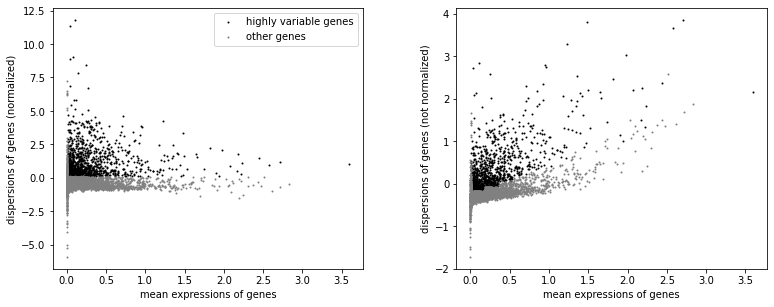

In [28]:
sc.pl.highly_variable_genes(maize_single_cell_trimmed_to_orthologs)


In [29]:
sc.pp.pca(maize_single_cell_trimmed_to_orthologs)
sc.pp.neighbors(maize_single_cell_trimmed_to_orthologs)
sc.tl.umap(maize_single_cell_trimmed_to_orthologs, random_state=20)

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [30]:
sc.set_figure_params(facecolor = 'white', figsize = (15,15))

In [31]:
sc.tl.leiden(maize_single_cell_trimmed_to_orthologs, random_state = 50)

In [32]:
maize_single_cell_trimmed_to_orthologs.var.loc[maize_single_cell_trimmed_to_orthologs.var['features']== 'KN-1']

,_index,features,Arabidopsis Gene,GRM Name,highly_variable,means,dispersions,dispersions_norm


In [33]:
maize_single_cell.var.loc['GRMZM2G372364']

_index              GRMZM2G372364
features            GRMZM2G372364
Arabidopsis Gene              NaN
GRM Name                      NaN
Name: GRMZM2G372364, dtype: object

In [34]:
maize_single_cell.obsm['X_umap']

array([[-1.24868038,  2.23365191],
       [-4.71031561,  1.73476366],
       [ 1.41274533,  1.85823373],
       ...,
       [-3.27618447,  2.46618585],
       [-3.75875845,  1.31210891],
       [-5.12317315, -1.43737992]])

In [35]:
maize_single_cell_trimmed_to_orthologs.uns['leiden']

{'params': {'resolution': 1, 'random_state': 50, 'n_iterations': -1}}

In [36]:
maize_single_cell.obs['leiden'] = maize_single_cell_trimmed_to_orthologs.obs['leiden']
#maize_single_cell.uns['leiden_colors'] = maize_single_cell_trimmed_to_orthologs.uns['leiden_colors']


In [37]:
list_of_arabidopsis_groups = np.arange(0,17)
list_of_arabidopsis_groups = [str(x) for x in list_of_arabidopsis_groups]
list_of_arabidopsis_groups

['0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16']

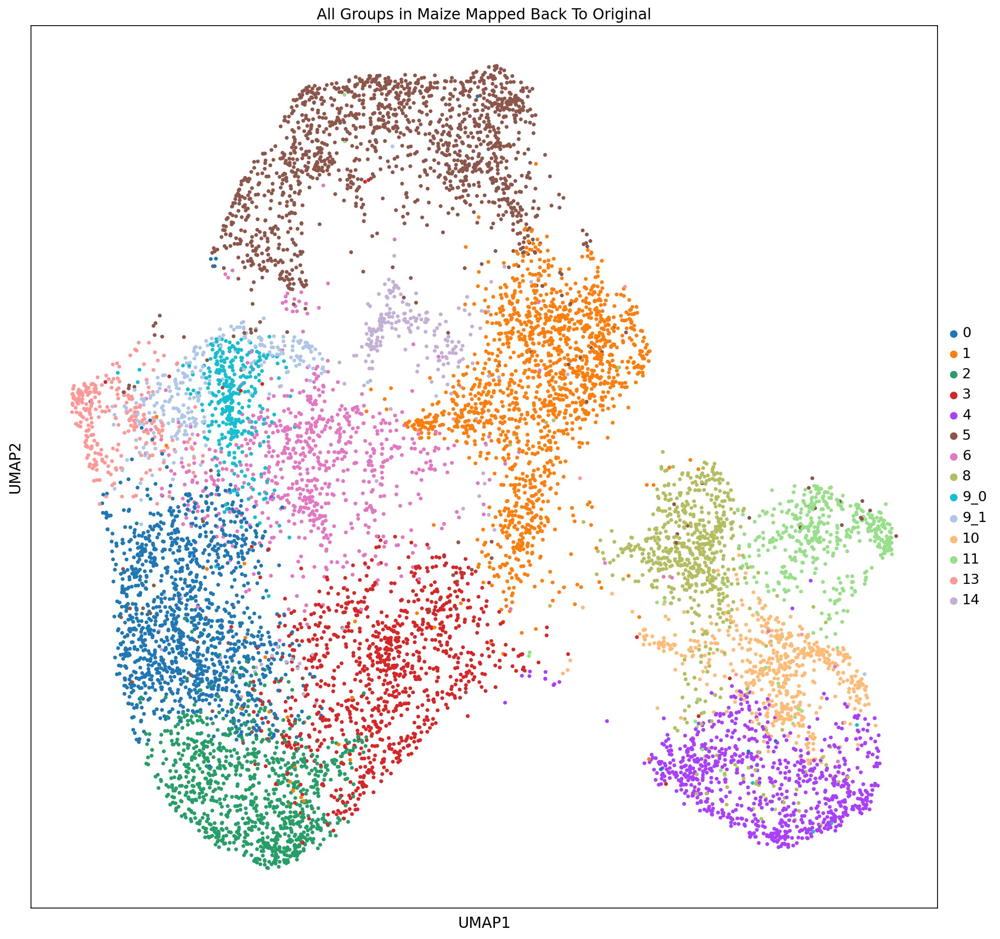

In [38]:
sc.pl.umap(maize_single_cell, color='Original_Jack_Clusters', s= 50, title = f"All Groups in Maize Mapped Back To Original")

In [39]:
arabi_single_cell

AnnData object with n_obs × n_vars = 20224 × 23339
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'RNA_snn_res.0.5', 'seurat_clusters', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54', 'Original_Jack_Clusters'
    var: '_index', 'features', 'Arabidopsis Gene', 'GRM Name'
    obsm: 'X_umap'

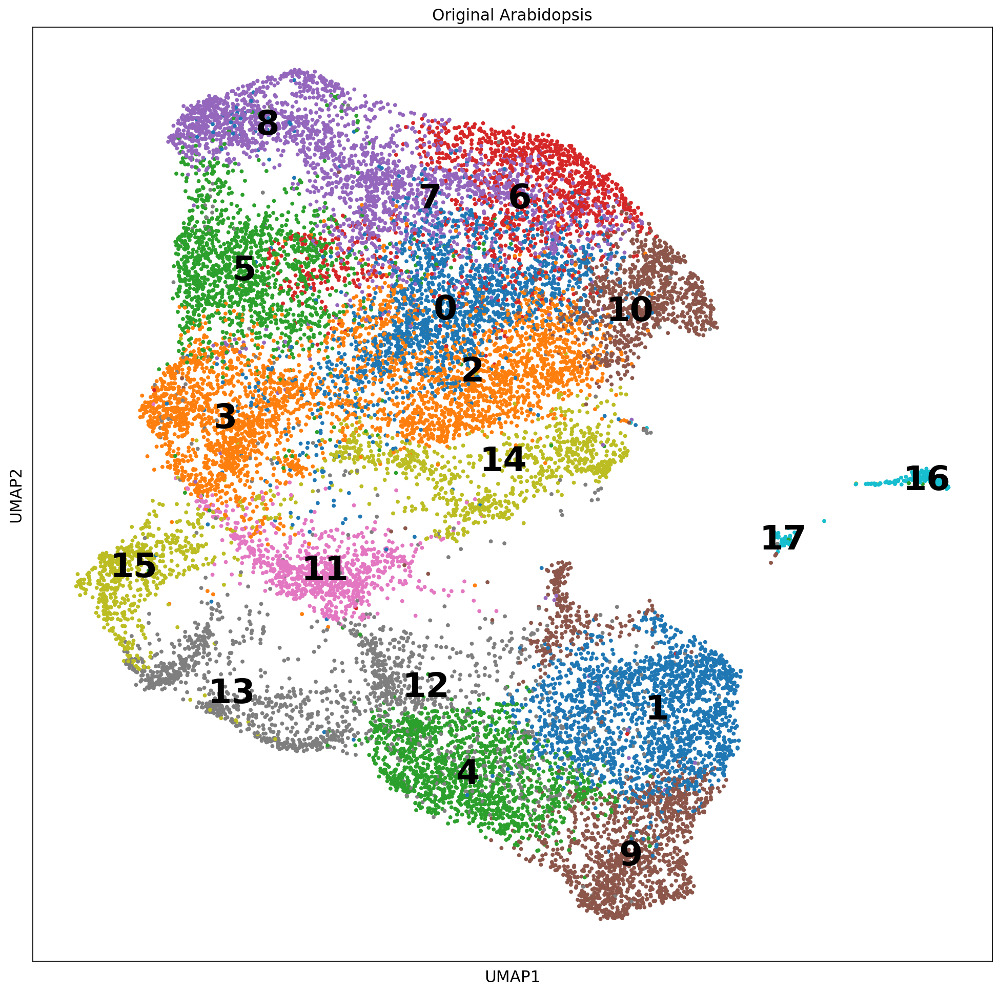

In [40]:
sc.pl.umap(arabi_single_cell, color='Original_Jack_Clusters', s= 50, title = "Original Arabidopsis", palette = 'tab10', legend_loc = 'on data', legend_fontsize= 30,)

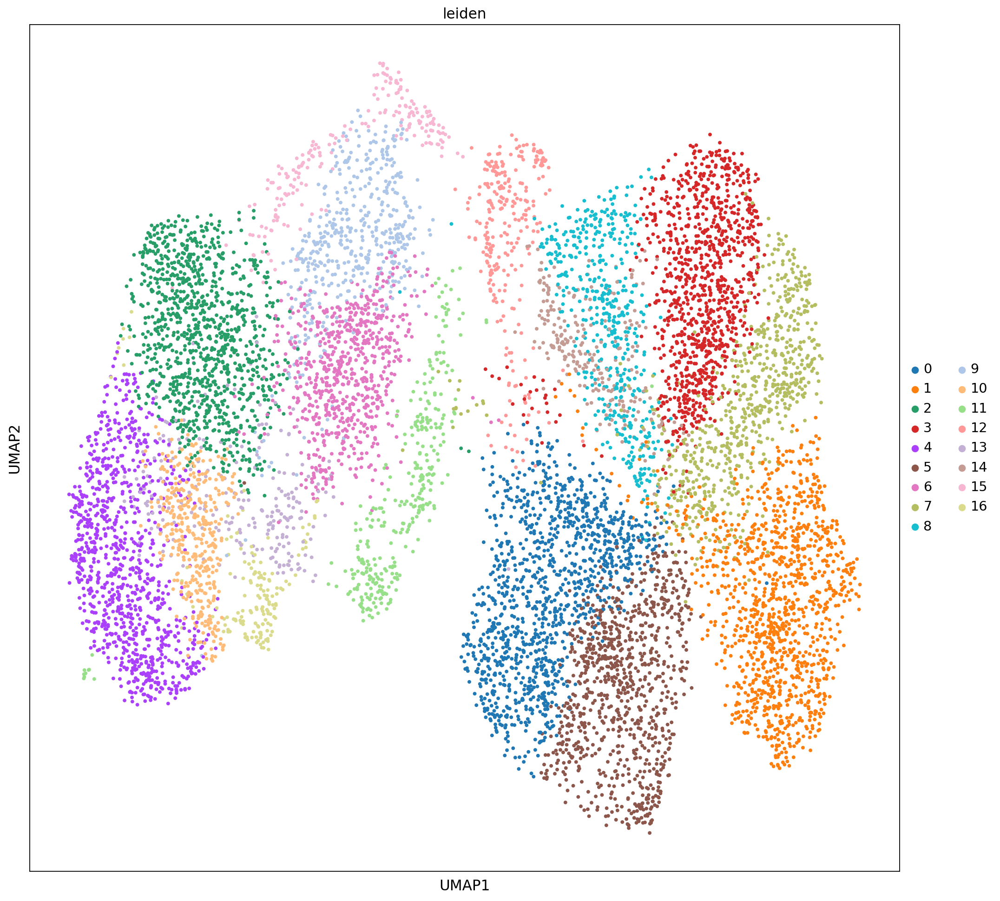

In [41]:
sc.pl.umap(maize_single_cell_trimmed_to_orthologs, color='leiden', s= 50,)

In [42]:
maize_cell_cycle_obs = maize_single_cell_trimmed_to_orthologs.obs.loc[maize_single_cell_trimmed_to_orthologs.obs['Original_Jack_Clusters'].isin(['1','5','8','11'])].index
maize_epidermis_obs = maize_single_cell_trimmed_to_orthologs.obs.loc[maize_single_cell_trimmed_to_orthologs.obs['Original_Jack_Clusters'].isin(['10','4'])].index
maize_all_other_obs = maize_single_cell_trimmed_to_orthologs.obs.loc[maize_single_cell_trimmed_to_orthologs.obs['Original_Jack_Clusters'].isin(['0','2','3','6','7','9','12','13','14','9_0',"9_1"])].index


In [43]:
arabi_cell_cycle_obs = arabi_single_cell_slimmed_to_orthologs.obs.loc[arabi_single_cell_slimmed_to_orthologs.obs['Original_Jack_Clusters'].isin(['11','12','13','15'])].index
arabi_epidermis_obs = arabi_single_cell_slimmed_to_orthologs.obs.loc[arabi_single_cell_slimmed_to_orthologs.obs['Original_Jack_Clusters'].isin(['1','4','9'])].index
arabi_all_other_obs = arabi_single_cell_slimmed_to_orthologs.obs.loc[arabi_single_cell_slimmed_to_orthologs.obs['Original_Jack_Clusters'].isin(['0','2','3','5','6','7','8','10','14','16','17'])].index


In [44]:
maize_cell_cycle_obs

Index(['AAACGAAAGTGCAAAT-1_1', 'AAAGAACTCTTACACT-1_1', 'AAAGGATTCATGGGAG-1_1',
       'AAAGGGCCAGTCACGC-1_1', 'AAAGGTAGTGTGCTTA-1_1', 'AAAGTCCCACCGAATT-1_1',
       'AAAGTGAGTGGAGAAA-1_1', 'AAAGTGATCTACGGGC-1_1', 'AAATGGATCCTCTGCA-1_1',
       'AACAAAGCAGTCGGTC-1_1',
       ...
       'TTTCAGTGTTAGGGTG-1_4', 'TTTCAGTGTTTACTGG-1_4', 'TTTCAGTTCTTGTTAC-1_4',
       'TTTGACTAGCACTCGC-1_4', 'TTTGACTAGCTGTGCC-1_4', 'TTTGACTTCCTTATAC-1_4',
       'TTTGATCAGCATCCCG-1_4', 'TTTGATCGTAGAAACT-1_4', 'TTTGATCGTAGTGATA-1_4',
       'TTTGGTTCAAACGAGC-1_4'],
      dtype='object', length=4137)

In [45]:
cell_cycle_maize = maize_single_cell_trimmed_to_orthologs[maize_single_cell_trimmed_to_orthologs.obs.index.isin(maize_cell_cycle_obs),:]
epi_maize = maize_single_cell_trimmed_to_orthologs[maize_single_cell_trimmed_to_orthologs.obs.index.isin(maize_epidermis_obs),:]
all_others_maize = maize_single_cell_trimmed_to_orthologs[maize_single_cell_trimmed_to_orthologs.obs.index.isin(maize_all_other_obs),:]


In [46]:
cell_cycle_arabi = arabi_single_cell_slimmed_to_orthologs[arabi_single_cell_slimmed_to_orthologs.obs.index.isin(arabi_cell_cycle_obs),:]
epi_arabi = arabi_single_cell_slimmed_to_orthologs[arabi_single_cell_slimmed_to_orthologs.obs.index.isin(arabi_epidermis_obs),:]
all_others_arabi = arabi_single_cell_slimmed_to_orthologs[arabi_single_cell_slimmed_to_orthologs.obs.index.isin(arabi_all_other_obs),:]

In [47]:
cell_cycle_arabi

View of AnnData object with n_obs × n_vars = 3234 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'RNA_snn_res.0.5', 'seurat_clusters', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54', 'Original_Jack_Clusters', 'Species'
    var: '_index', 'features', 'Arabidopsis Gene', 'GRM Name'
    obsm: 'X_umap'

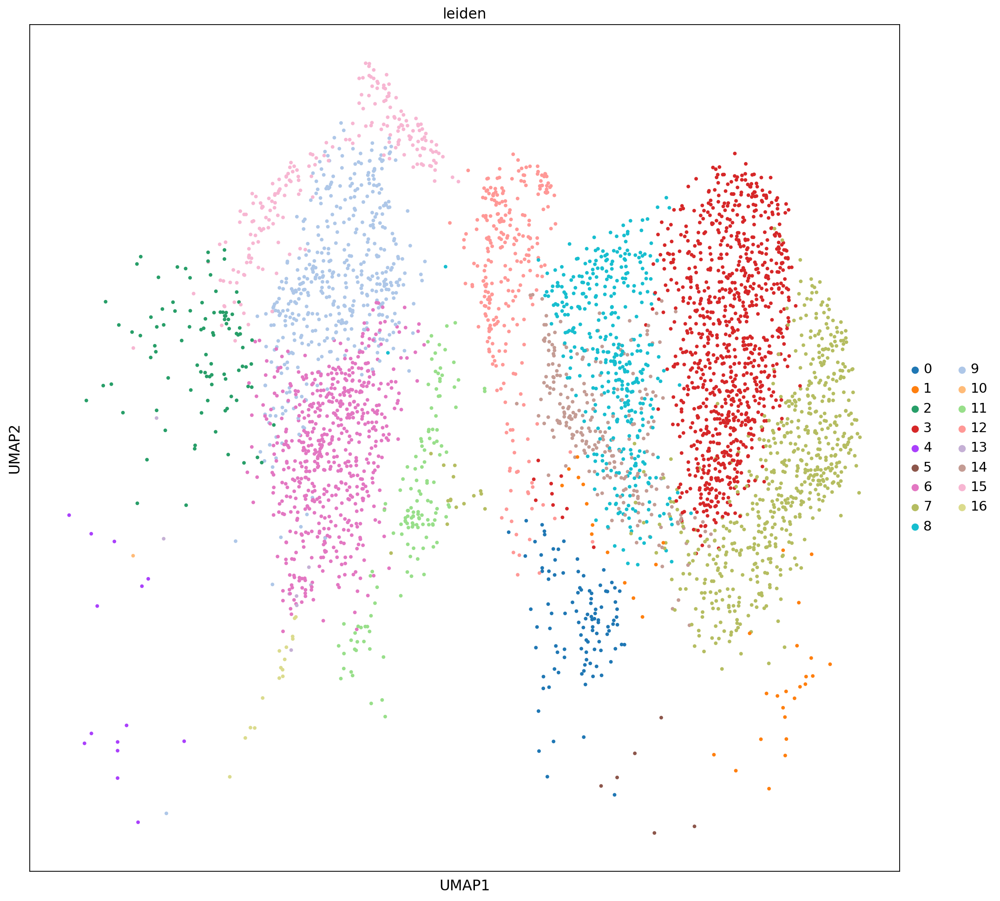

In [48]:
sc.pl.umap(cell_cycle_maize, color='leiden', s= 50,)

In [49]:
cell_cycle_arabi.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,RNA_snn_res.0.5,seurat_clusters,source,integrated_snn_res.0.5,integrated_snn_res.0.75,integrated_snn_res.1,...,integrated_snn_res.0.7,integrated_snn_res.0.8,integrated_snn_res.0.65,integrated_snn_res.0.6,integrated_snn_res.0.55,integrated_snn_res.0.53,integrated_snn_res.0.52,integrated_snn_res.0.54,Original_Jack_Clusters,Species
AAACCCACAGAGAATT-1_1,xu41_l151,2507.0,1423,0.000000,1,7,xu41,7,13,12,...,12,12,12,11,11,7,6,7,13,Arabidopsis
AAACCCAGTCTCGGAC-1_1,xu41_l151,3596.0,1394,0.027809,1,2,xu41,0,12,11,...,0,11,0,0,0,0,0,2,12,Arabidopsis
AAACCCAGTTCGGTAT-1_1,xu41_l151,19458.0,4287,0.000000,8,10,xu41,11,11,10,...,11,10,11,10,10,11,11,10,11,Arabidopsis
AAACGAAAGTAACCTC-1_1,xu41_l151,28022.0,5046,0.000000,8,10,xu41,11,11,10,...,11,10,11,10,10,11,11,10,11,Arabidopsis
AAACGAATCACAACCA-1_1,xu41_l151,3065.0,1421,0.032626,8,10,xu41,11,11,10,...,11,10,11,10,10,11,11,10,11,Arabidopsis
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGAGCAGCGTGAA-1_2,xu42_l151,392.0,321,0.000000,1,7,xu42,7,15,14,...,14,14,14,13,13,7,6,7,15,Arabidopsis
TTTGGAGTCTCCCTAG-1_2,xu42_l151,2875.0,1318,0.000000,7,7,xu42,7,13,12,...,12,12,12,11,11,7,6,7,13,Arabidopsis
TTTGTTGCACTGGCGT-1_2,xu42_l151,30050.0,7525,0.009983,7,7,xu42,7,13,12,...,12,12,12,11,11,7,6,7,13,Arabidopsis
TTTGTTGCAGAGTAAT-1_2,xu42_l151,23882.0,6459,0.008375,2,2,xu42,0,12,11,...,0,11,0,0,0,0,0,2,12,Arabidopsis


In [50]:
import scanorama
sc.pp.pca(cell_cycle_maize)
sc.pp.pca(cell_cycle_arabi)

### Working External Integration
# concat_cell_cycle = cell_cycle_maize.concatenate(cell_cycle_arabi, batch_key = 'Species', batch_categories = ['Maize','Arabidopsis'])
# sc.external.pp.scanorama_integrate(concat_cell_cycle, key = 'Species')



# sc.pp.neighbors(concat_cell_cycle, n_neighbors = 10, n_pcs = 40, use_rep= 'X_scanorama', random_state = 2204)
# sc.tl.umap(concat_cell_cycle, random_state= 243)
# sc.pl.umap(concat_cell_cycle, color= ['Species'], s = 40,)
concat_cell_cycle = cell_cycle_maize.concatenate(cell_cycle_arabi, batch_key = 'Species', batch_categories = ['Maize','Arabidopsis'])
curr_batch = None
batch_names = []
name2idx = {}
for idx in range(concat_cell_cycle.X.shape[0]):
    batch_name = concat_cell_cycle.obs['Species'][idx]
    if batch_name != curr_batch:
        curr_batch = batch_name
        if batch_name in batch_names:
            # Contiguous batches important for preserving cell order.
            raise ValueError('Detected non-contiguous batches.')
        batch_names.append(batch_name)  # Preserve name order.
        name2idx[batch_name] = []
    name2idx[batch_name].append(idx)

datasets_dimred = [
    concat_cell_cycle.obsm['X_pca'][name2idx[batch_name]] for batch_name in batch_names
]
integrated = scanorama.assemble(
    datasets_dimred,  # Assemble in low dimensional space.
    ds_names=batch_names,
)
concat_cell_cycle.obsm['X_scanorama'] = np.concatenate(integrated)
# sc.pp.neighbors(concat_cell_cycle, n_neighbors = 10, n_pcs = 40, use_rep= 'X_scanorama', random_state = 2204)
# sc.tl.umap(concat_cell_cycle, random_state= 243)
# sc.pl.umap(concat_cell_cycle, color= ['Species'], s = 40,)

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


[[0.         0.88228185]
 [0.         0.        ]]
Processing datasets Maize <=> Arabidopsis


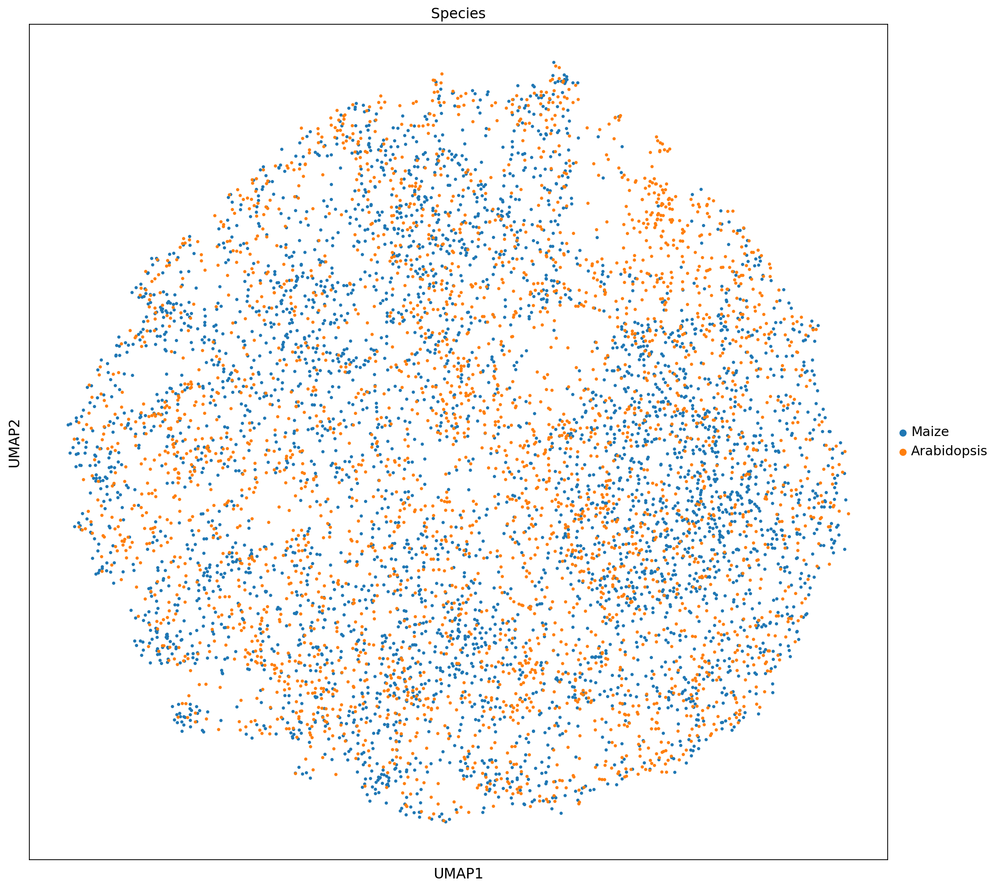

In [51]:
sc.pp.neighbors(concat_cell_cycle, n_neighbors = 10, n_pcs = 40, use_rep= 'X_scanorama', random_state = 2204)
sc.tl.umap(concat_cell_cycle, random_state= 243)
sc.pl.umap(concat_cell_cycle, color= ['Species'], s = 40,)

In [52]:
concat_cell_cycle.obs['Species']

AAACGAAAGTGCAAAT-1_1-Maize                Maize
AAAGAACTCTTACACT-1_1-Maize                Maize
AAAGGATTCATGGGAG-1_1-Maize                Maize
AAAGGGCCAGTCACGC-1_1-Maize                Maize
AAAGGTAGTGTGCTTA-1_1-Maize                Maize
                                       ...     
TTTGGAGCAGCGTGAA-1_2-Arabidopsis    Arabidopsis
TTTGGAGTCTCCCTAG-1_2-Arabidopsis    Arabidopsis
TTTGTTGCACTGGCGT-1_2-Arabidopsis    Arabidopsis
TTTGTTGCAGAGTAAT-1_2-Arabidopsis    Arabidopsis
TTTGTTGTCGGAGCAA-1_2-Arabidopsis    Arabidopsis
Name: Species, Length: 7371, dtype: category
Categories (2, object): ['Maize', 'Arabidopsis']

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


[[0.         0.97662527]
 [0.         0.        ]]
Processing datasets Maize <=> Arabidopsis


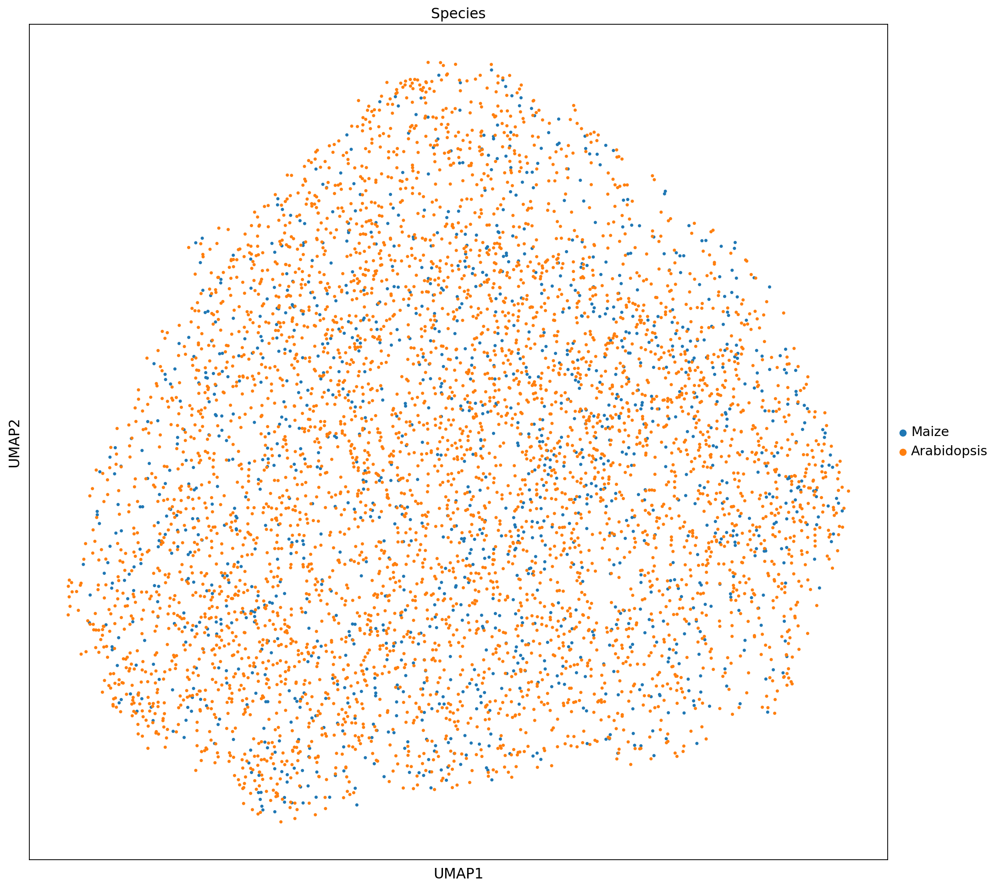

In [53]:
sc.pp.pca(epi_maize)
sc.pp.pca(epi_arabi)
concat_epi = epi_maize.concatenate(epi_arabi, batch_key = 'Species', batch_categories = ['Maize','Arabidopsis'])
sc.external.pp.scanorama_integrate(concat_epi,'Species')
sc.pp.neighbors(concat_epi, n_neighbors = 10, n_pcs = 40, use_rep= 'X_scanorama', random_state = 2204)
sc.tl.umap(concat_epi, random_state= 243)
sc.pl.umap(concat_epi, color= ['Species'], s = 40,)

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


[[0.         0.94648167]
 [0.         0.        ]]
Processing datasets Maize <=> Arabidopsis


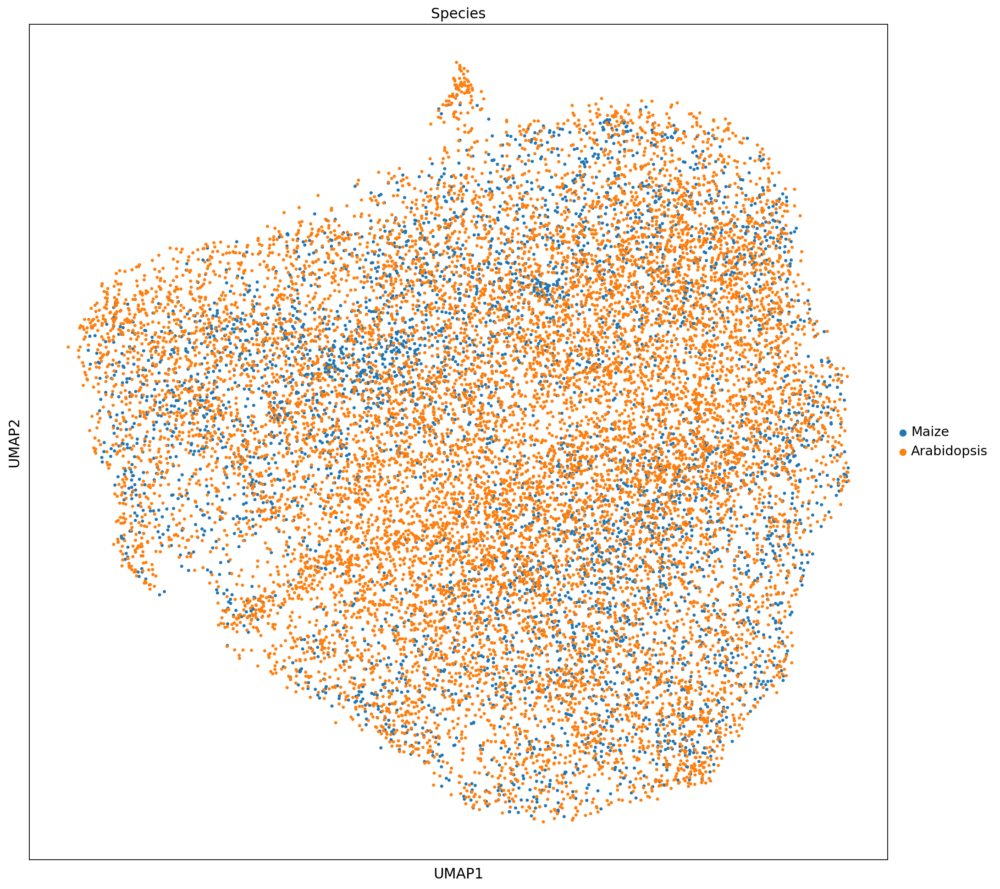

In [54]:
sc.pp.pca(all_others_maize)
sc.pp.pca(all_others_arabi)
concat_all_others = all_others_maize.concatenate(all_others_arabi, batch_key = 'Species', batch_categories = ['Maize','Arabidopsis'])
sc.external.pp.scanorama_integrate(concat_all_others,'Species')
sc.pp.neighbors(concat_all_others, n_neighbors = 10, n_pcs = 40, use_rep= 'X_scanorama', random_state = 2204)
sc.tl.umap(concat_all_others, random_state= 243)
sc.pl.umap(concat_all_others, color= ['Species'], s = 40,)

In [55]:
concat_all_others

AnnData object with n_obs × n_vars = 17521 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1', 'Original_Jack_Clusters', 'Species', 'leiden', 'percent.mt', 'RNA_snn_res.0.5', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54'
    var: 'Arabidopsis Gene', 'GRM Name', '_index-Arabidopsis', 'features-Arabidopsis', '_index-Maize', 'features-Maize', 'highly_variable-Maize', 'means-Maize', 'dispersions-Maize', 'dispersions_norm-Maize'
    uns: 'neighbors', 'umap', 'Species_colors'
    obsm: 'X_umap', 'X_pca', 'X_scanorama'


/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


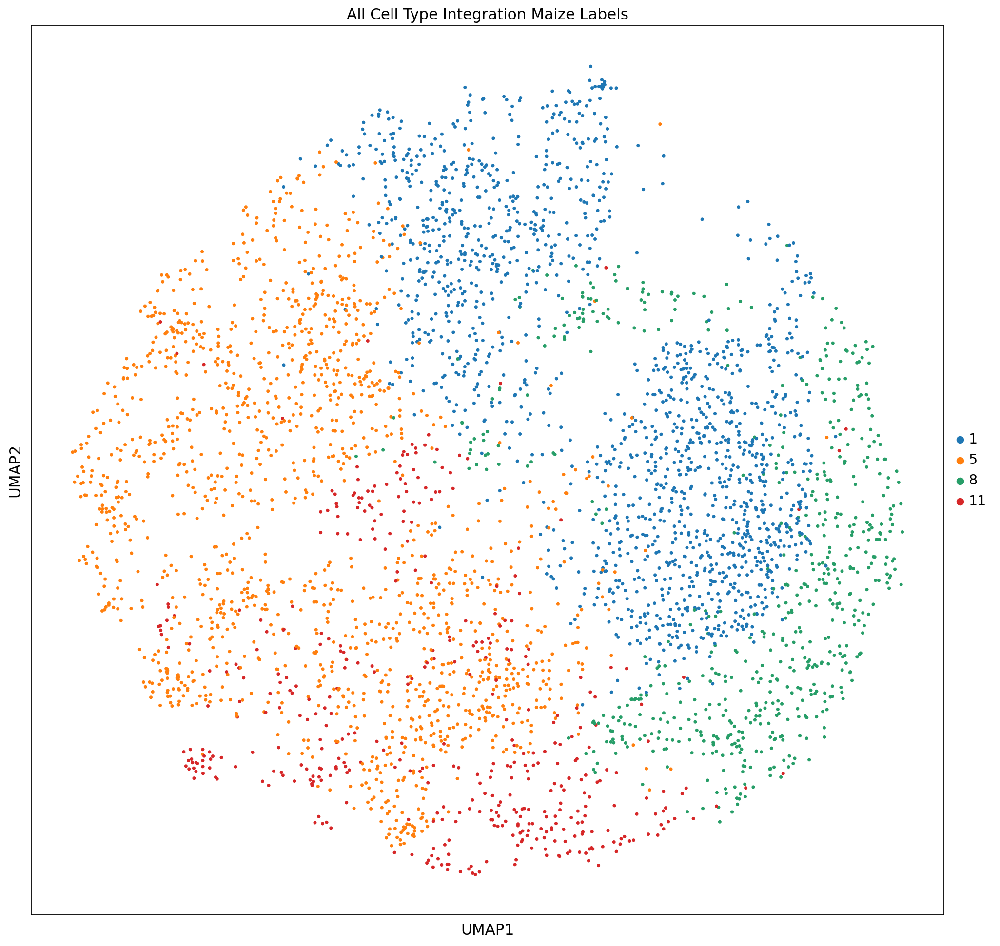

In [56]:
resubset = concat_cell_cycle[concat_cell_cycle.obs['Species'] == 'Maize']
sc.pl.umap(resubset, color= ['Original_Jack_Clusters'], s = 40, title = 'All Cell Type Integration Maize Labels')


/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


[[0.         0.51515152 0.37180424 0.48199178 0.38844573 0.69543147]
 [0.         0.         0.35281227 0.48670377 0.46413111 0.66790353]
 [0.         0.         0.         0.42878013 0.36961286 0.55661066]
 [0.         0.         0.         0.         0.44301288 0.69051839]
 [0.         0.         0.         0.         0.         0.72190287]
 [0.         0.         0.         0.         0.         0.        ]]
Processing datasets Maize Others <=> Arabi Others
Processing datasets Maize Cell Cycle <=> Arabi Others
Processing datasets Arabi Epi <=> Arabi Others
Processing datasets Arabi Cell Cycle <=> Arabi Others
Processing datasets Maize Epi <=> Arabi Others
Processing datasets Maize Cell Cycle <=> Arabi Cell Cycle
Processing datasets Arabi Cell Cycle <=> Arabi Epi
Processing datasets Maize Cell Cycle <=> Arabi Epi
Processing datasets Arabi Cell Cycle <=> Maize Others
Processing datasets Arabi Epi <=> Maize Others
Processing datasets Maize Epi <=> Arabi Epi
Processing datasets Maize Ce

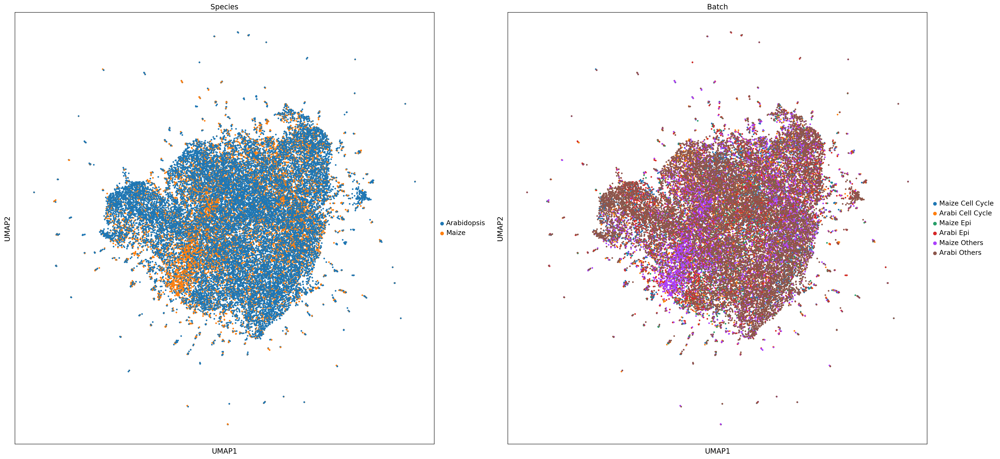

In [57]:
sc.pp.pca(cell_cycle_maize)
sc.pp.pca(cell_cycle_arabi)
sc.pp.pca(epi_maize)
sc.pp.pca(epi_arabi)
sc.pp.pca(all_others_maize)
sc.pp.pca(all_others_arabi)
full_concat_class_based = ad.concat([cell_cycle_maize,cell_cycle_arabi,epi_maize,epi_arabi,all_others_maize,all_others_arabi], label = 'Batch',keys = ['Maize Cell Cycle','Arabi Cell Cycle','Maize Epi','Arabi Epi','Maize Others','Arabi Others'], join = 'outer')
sc.external.pp.scanorama_integrate(full_concat_class_based,'Batch')
sc.pp.neighbors(full_concat_class_based, n_neighbors = 10, n_pcs = 40, use_rep= 'X_scanorama',)
sc.tl.umap(full_concat_class_based)
sc.pl.umap(full_concat_class_based, color= ['Species', 'Batch'], s = 40,)

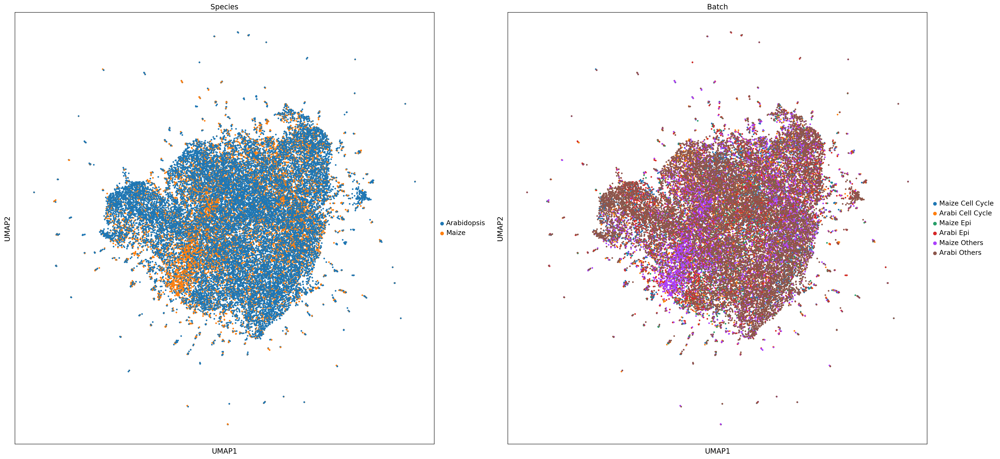

In [58]:
sc.pl.umap(full_concat_class_based, color= ['Species', 'Batch'], s = 40,)

In [59]:
full_concat_class_based

AnnData object with n_obs × n_vars = 30775 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1', 'Original_Jack_Clusters', 'Species', 'leiden', 'percent.mt', 'RNA_snn_res.0.5', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54', 'Batch'
    uns: 'neighbors', 'umap', 'Species_colors', 'Batch_colors'
    obsm: 'X_umap', 'X_pca', 'X_scanorama'
    obsp: 'distances', 'connectivities'

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


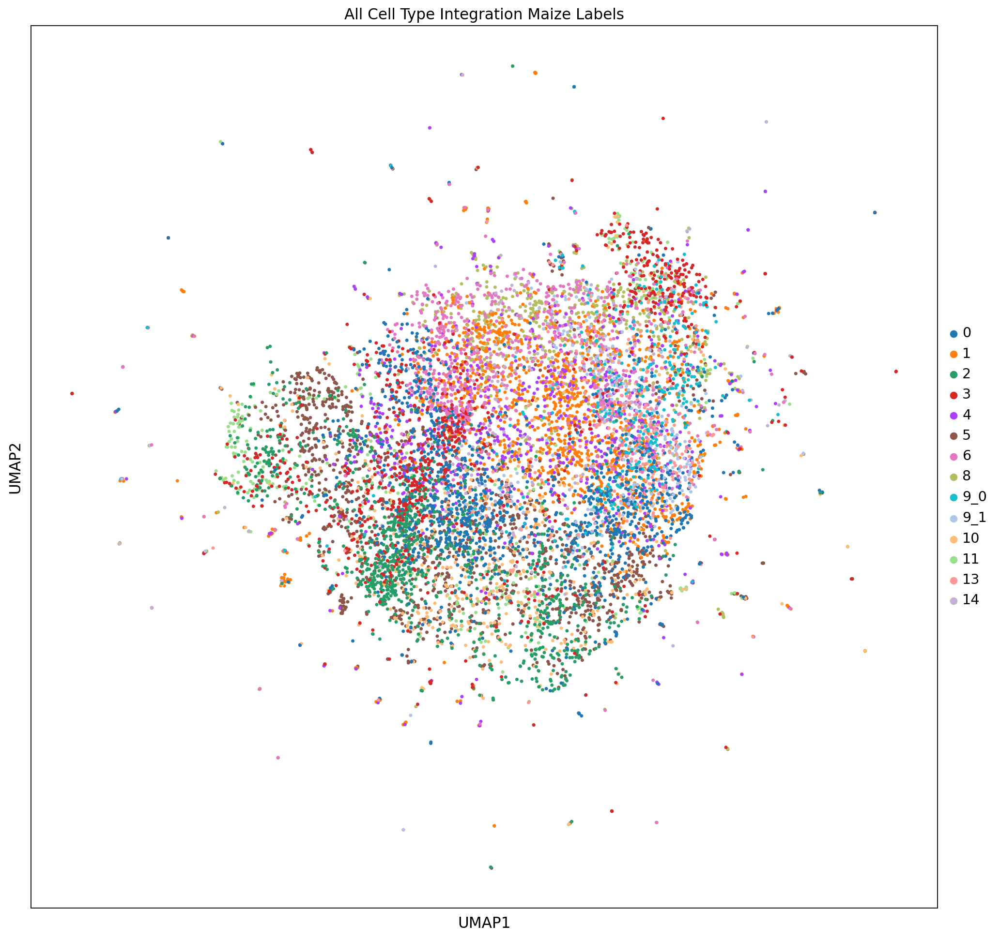

In [60]:
resubset = full_concat_class_based[full_concat_class_based.obs['Species'] == 'Maize']
sc.pl.umap(resubset, color= ['Original_Jack_Clusters'], s = 40, title = 'All Cell Type Integration Maize Labels')

[[0.         0.52530186 0.59187489]
 [0.         0.         0.59082892]
 [0.         0.         0.        ]]
Processing datasets Epidermis <=> All Other Cell Types
Processing datasets Cell Cycle <=> All Other Cell Types
Processing datasets Epidermis <=> Cell Cycle


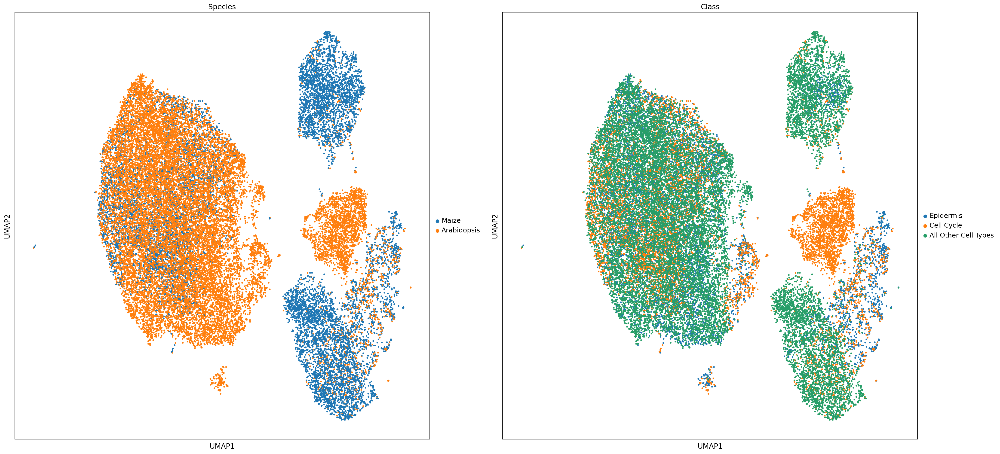

In [61]:
sc.pp.pca(concat_epi)
sc.pp.pca(concat_cell_cycle)
sc.pp.pca(concat_all_others)
full_concat_class_based = ad.concat([concat_epi,concat_cell_cycle,concat_all_others], label = 'Class',keys = ['Epidermis','Cell Cycle','All Other Cell Types'])
sc.external.pp.scanorama_integrate(full_concat_class_based,'Class')
sc.pp.neighbors(full_concat_class_based, n_neighbors = 10, n_pcs = 40, use_rep= 'X_scanorama',)
sc.tl.umap(full_concat_class_based)
sc.pl.umap(full_concat_class_based, color= ['Species', 'Class'], s = 40,)

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


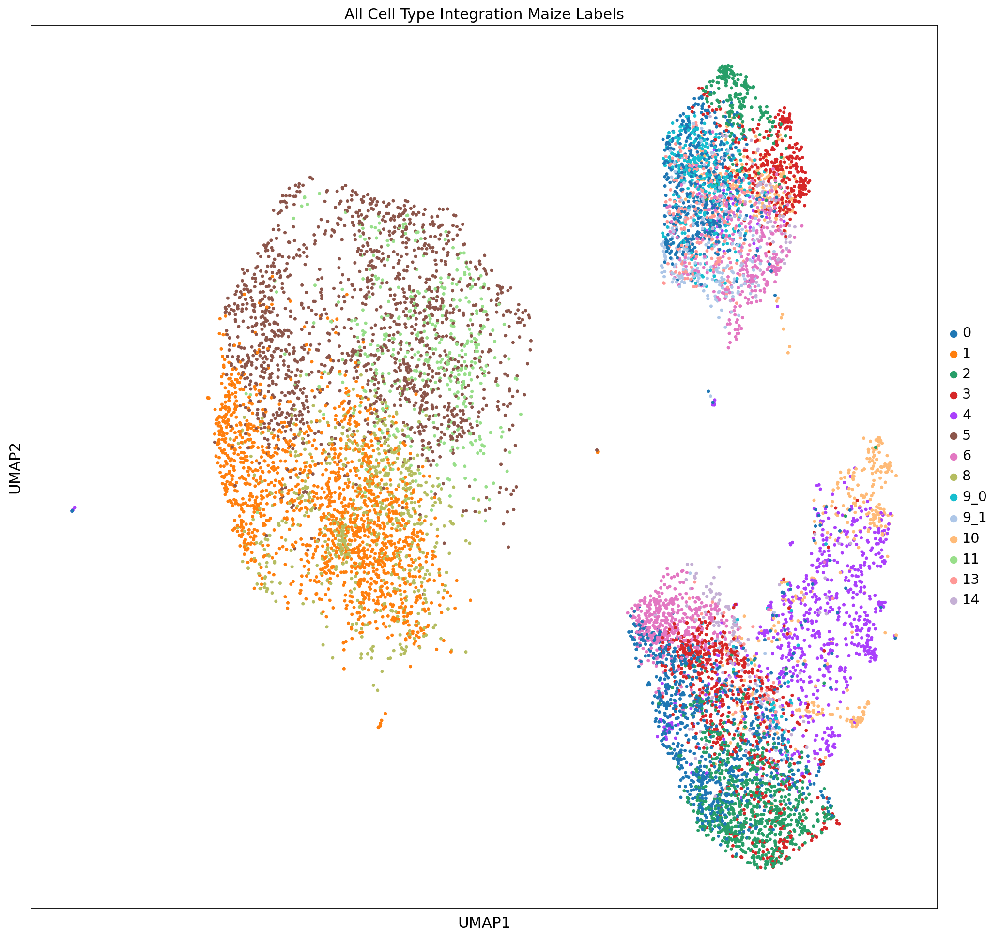

In [62]:
resubset = full_concat_class_based[full_concat_class_based.obs['Species'] == 'Maize']
sc.pl.umap(resubset, color= ['Original_Jack_Clusters'], s = 40, title = 'All Cell Type Integration Maize Labels')

/home/passala/miniconda3/envs/Single_cell_data/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


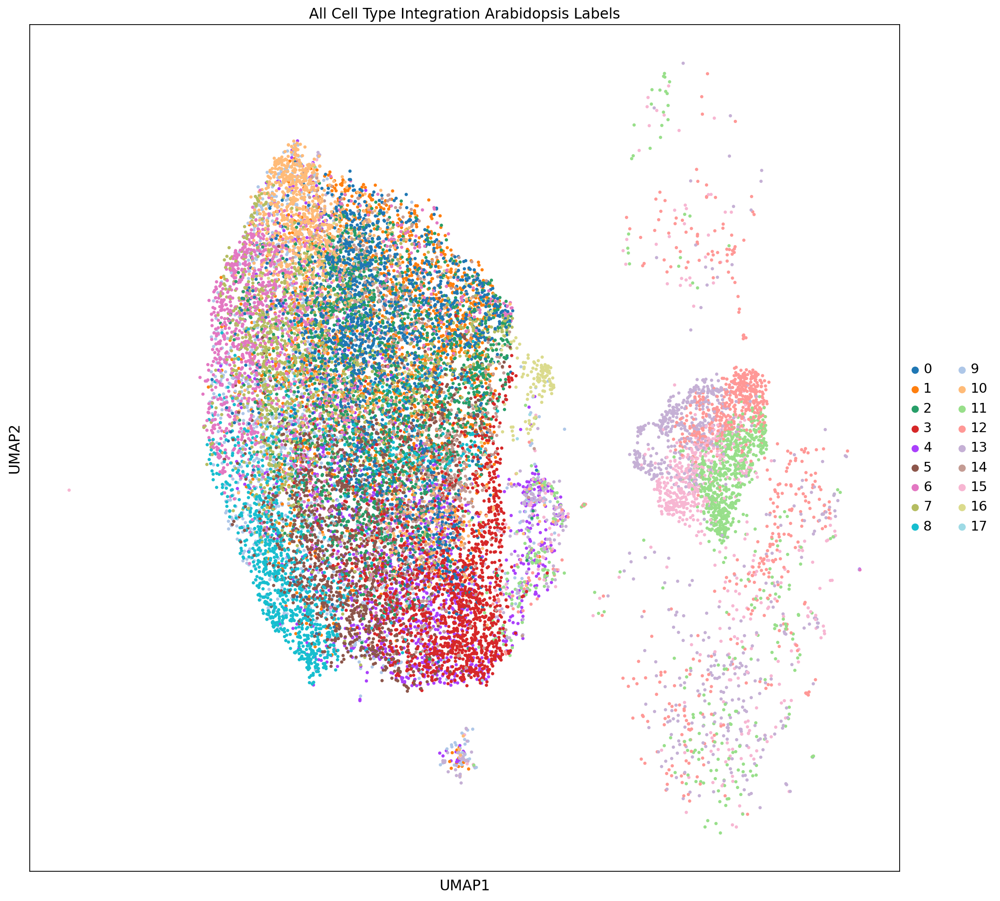

In [63]:
resubset = full_concat_class_based[full_concat_class_based.obs['Species'] == 'Arabidopsis']
sc.pl.umap(resubset, color= ['Original_Jack_Clusters'], s = 40, title = 'All Cell Type Integration Arabidopsis Labels')

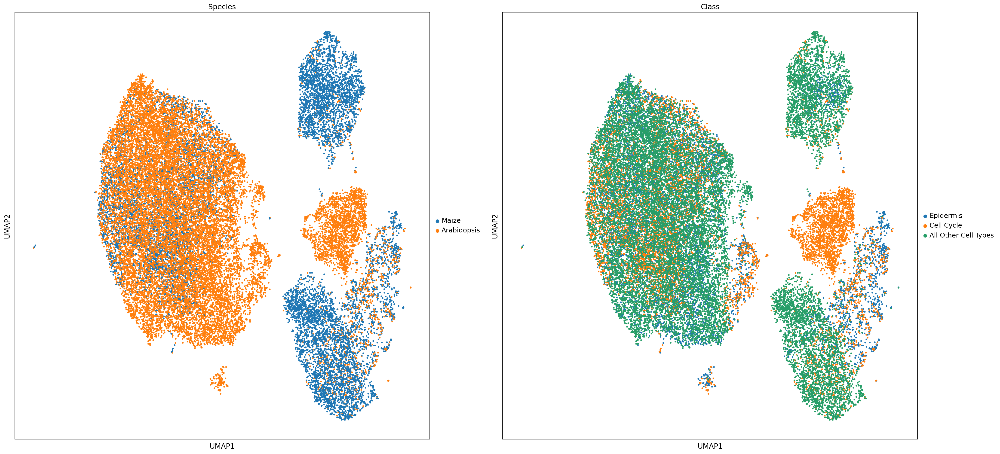

In [64]:
sc.pl.umap(full_concat_class_based, color= ['Species', 'Class'], s = 40,)

In [65]:
full_concat_class_based = ad.concat([concat_epi,concat_cell_cycle,concat_all_others], label = 'Class',keys = ['Epidermis','Cell Cycle','All Other Cell Types'])

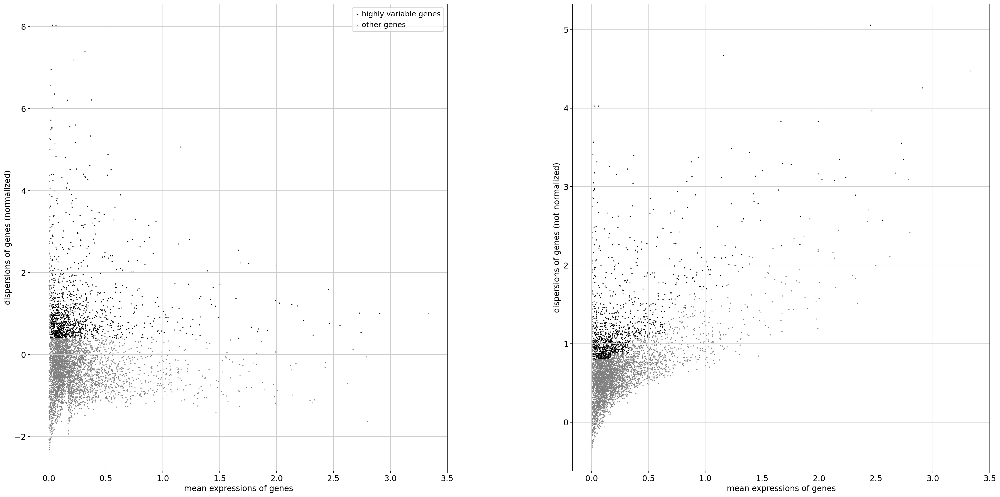

In [66]:
sc.pp.highly_variable_genes(full_concat_class_based, min_mean=0.0125, max_mean=3, min_disp=0.4)

sc.pl.highly_variable_genes(full_concat_class_based)

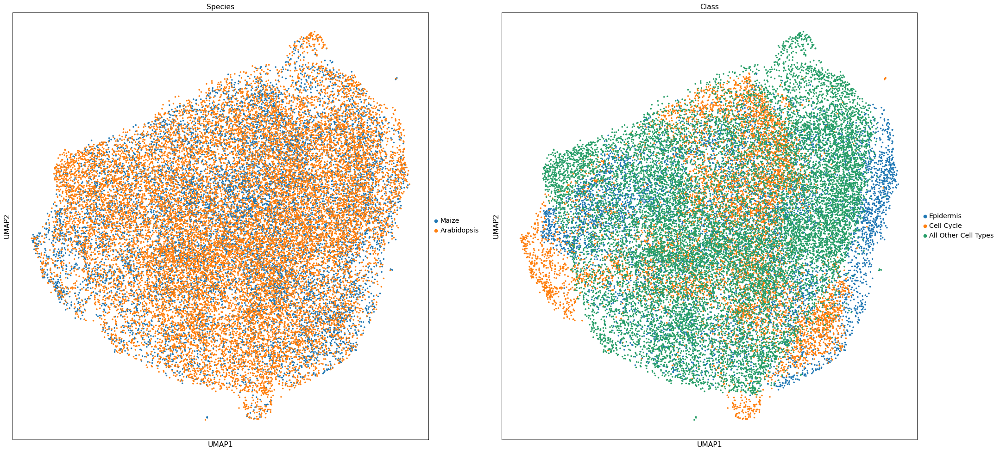

In [ ]:
sc.pp.neighbors(full_concat_class_based, n_neighbors = 10, n_pcs = 40, use_rep= 'X_scanorama', )
sc.tl.umap(full_concat_class_based,)
sc.pl.umap(full_concat_class_based, color= ['Species', 'Class'], s = 40,)

/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'determinate' as categorical
/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'subcluster9' as categorical
/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` paramet

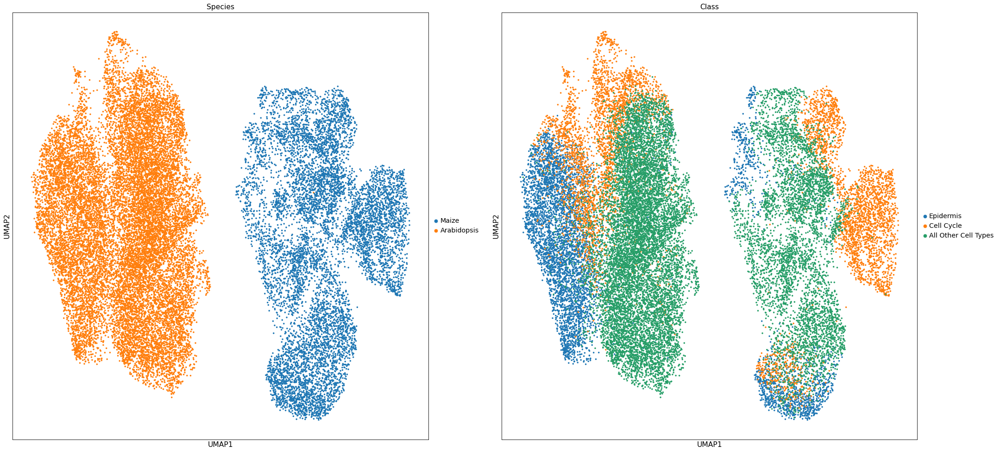

In [ ]:
sc.pl.umap(full_concat_class_based, color= ['Species', 'Class'], s = 40,)

In [ ]:
sc.pp.pca(cell_cycle_maize)
sc.pp.pca(cell_cycle_arabi)
sc.pp.neighbors(cell_cycle_maize)
sc.pp.neighbors(cell_cycle_arabi)


In [ ]:
sc.tl.ingest(cell_cycle_arabi,cell_cycle_maize, obs = 'leiden')
#cell_cycle_arabi.uns['leiden_colors'] = cell_cycle_maize.uns['leiden_colors']  # fix colors

In [ ]:
concat_cell_cycle = cell_cycle_maize.concatenate(cell_cycle_arabi, batch_key = 'Species', batch_categories = ['Maize','Arabidopsis'])
concat_cell_cycle

AnnData object with n_obs × n_vars = 6244 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1', 'leiden', 'percent.mt', 'RNA_snn_res.0.5', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54', 'Original_Jack_Clusters', 'Species'
    var: 'Arabidopsis Gene', 'GRM Name', 'features-Arabidopsis', 'features-Maize', 'highly_variable-Maize', 'means-Maize', 'dispersions-Maize', 'dispersions_norm-Maize'
    obsm: 'X_umap', 'X_pca'

/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'orig.ident' as categorical


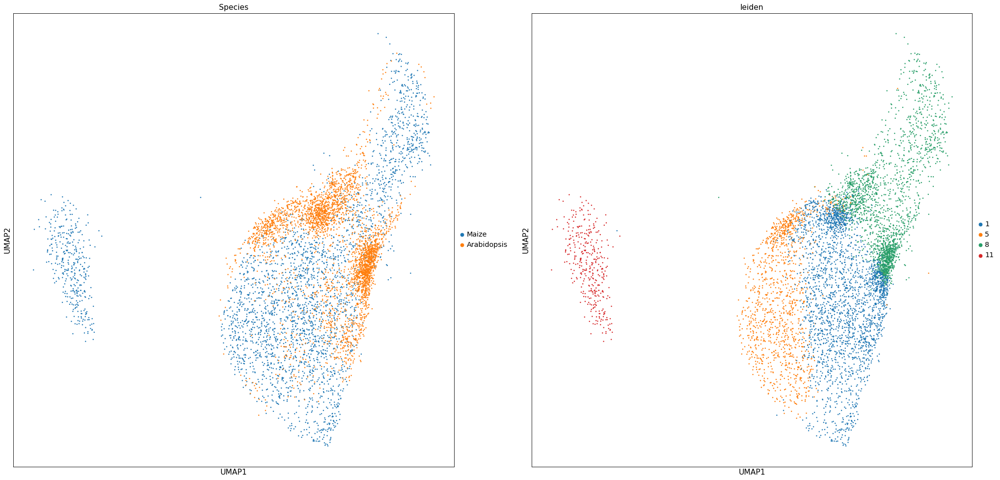

In [ ]:
sc.pl.umap(concat_cell_cycle, color=['Species','leiden'], s= 20)


In [ ]:
sc.pp.pca(epi_maize)
sc.pp.pca(epi_arabi)
sc.pp.neighbors(epi_maize)
sc.pp.neighbors(epi_arabi)
sc.tl.ingest(epi_arabi,epi_maize, obs = 'leiden')
concat_epi = epi_maize.concatenate(epi_arabi, batch_key = 'Species', batch_categories = ['Maize','Arabidopsis'])
concat_epi

AnnData object with n_obs × n_vars = 5883 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1', 'leiden', 'percent.mt', 'RNA_snn_res.0.5', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54', 'Original_Jack_Clusters', 'Species'
    var: 'Arabidopsis Gene', 'GRM Name', 'features-Arabidopsis', 'features-Maize', 'highly_variable-Maize', 'means-Maize', 'dispersions-Maize', 'dispersions_norm-Maize'
    obsm: 'X_umap', 'X_pca'

/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'orig.ident' as categorical
/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'DataSet' as categorical
/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in

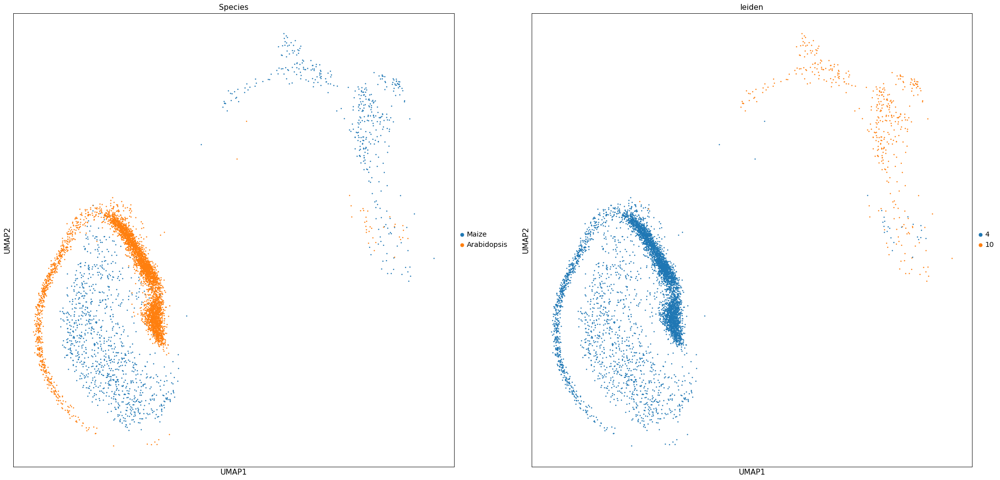

In [ ]:
sc.pl.umap(concat_epi, color=['Species','leiden'], s= 20)


In [ ]:
sc.pp.pca(all_others_maize)
sc.pp.pca(all_others_arabi)
sc.pp.neighbors(all_others_maize)
sc.pp.neighbors(all_others_arabi)
sc.tl.ingest(all_others_arabi,all_others_maize, obs = 'leiden')
concat_all_others = all_others_maize.concatenate(all_others_arabi, batch_key = 'Species', batch_categories = ['Maize','Arabidopsis'])
concat_all_others

AnnData object with n_obs × n_vars = 15599 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1', 'leiden', 'percent.mt', 'RNA_snn_res.0.5', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54', 'Original_Jack_Clusters', 'Species'
    var: 'Arabidopsis Gene', 'GRM Name', 'features-Arabidopsis', 'features-Maize', 'highly_variable-Maize', 'means-Maize', 'dispersions-Maize', 'dispersions_norm-Maize'
    obsm: 'X_umap', 'X_pca'

/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'orig.ident' as categorical
/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'DataSet' as categorical
/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in

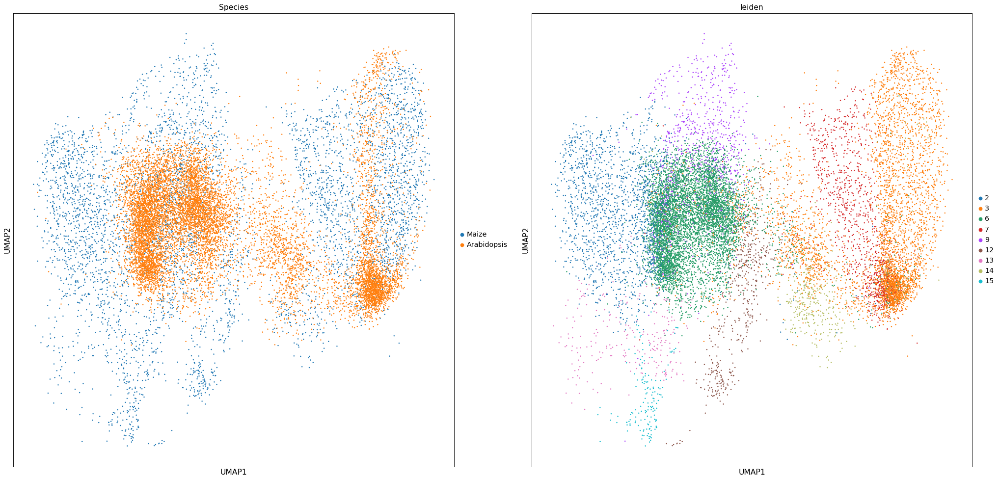

In [ ]:
sc.pl.umap(concat_all_others, color=['Species','leiden'], s= 20)


In [ ]:
full_concat_class_based = ad.concat([concat_epi,concat_cell_cycle,concat_all_others])


/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'determinate' as categorical
/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'subcluster9' as categorical
/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/anndata-0.7.6-py3.9.egg/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` paramet

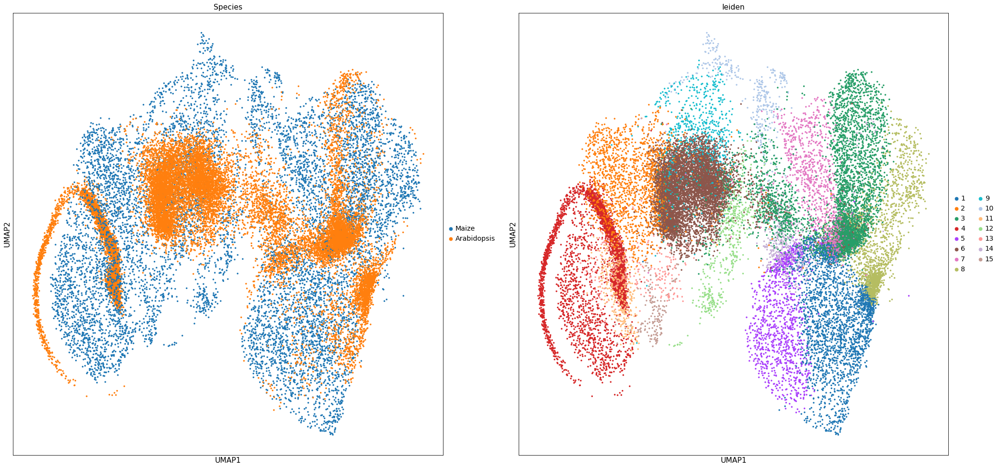

In [ ]:
sc.pl.umap(full_concat_class_based, color=['Species','leiden'], s= 40)


In [ ]:
sc.tl.ingest(arabi_single_cell_slimmed_to_orthologs,maize_single_cell_trimmed_to_orthologs, obs = 'leiden')
arabi_single_cell_slimmed_to_orthologs.uns['leiden_colors'] = maize_single_cell_trimmed_to_orthologs.uns['leiden_colors']  # fix colors


In [ ]:
arabi_single_cell_slimmed_to_orthologs.uns

OverloadedDict, wrapping:
	OrderedDict([('leiden_colors', ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b', '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896', '#c5b0d5', '#c49c94', '#f7b6d2', '#dbdb8d'])])
With overloaded keys:
	['neighbors'].

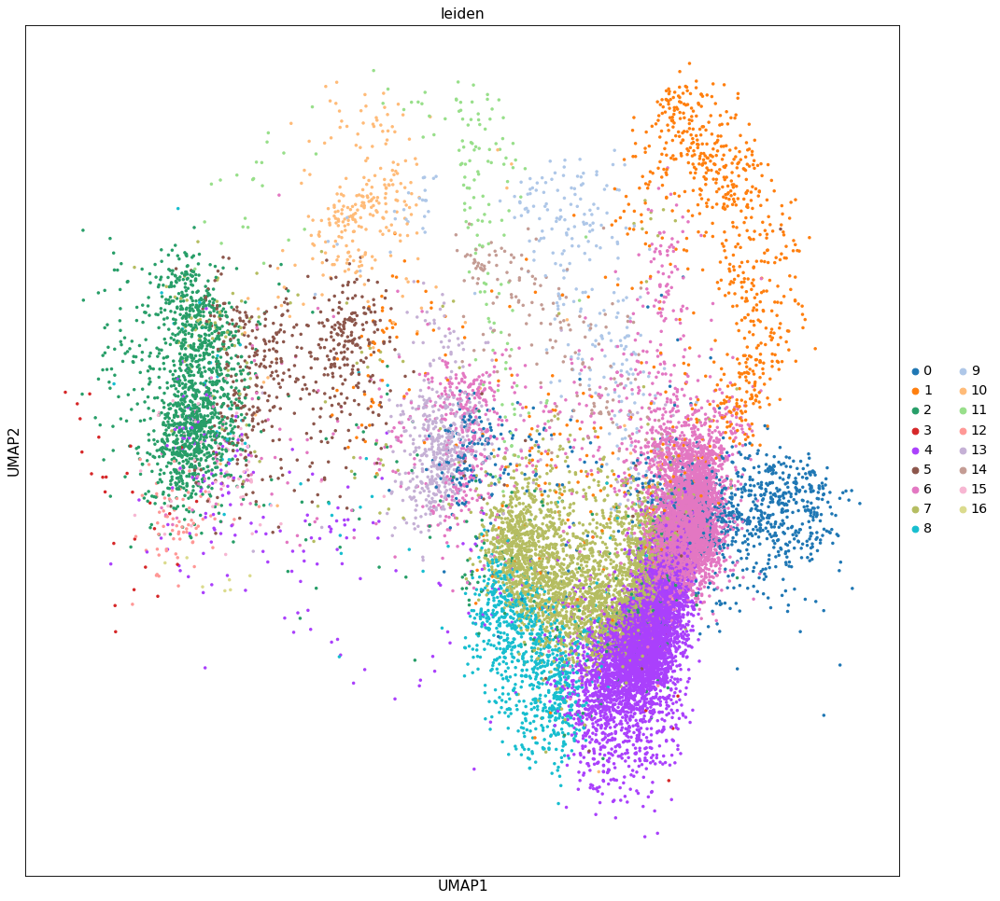

In [ ]:
sc.pl.umap(arabi_single_cell_slimmed_to_orthologs, color='leiden', wspace=0.5, s = 40, save = "_arabidopsis_only_aligned_to_maize_clusters.png")


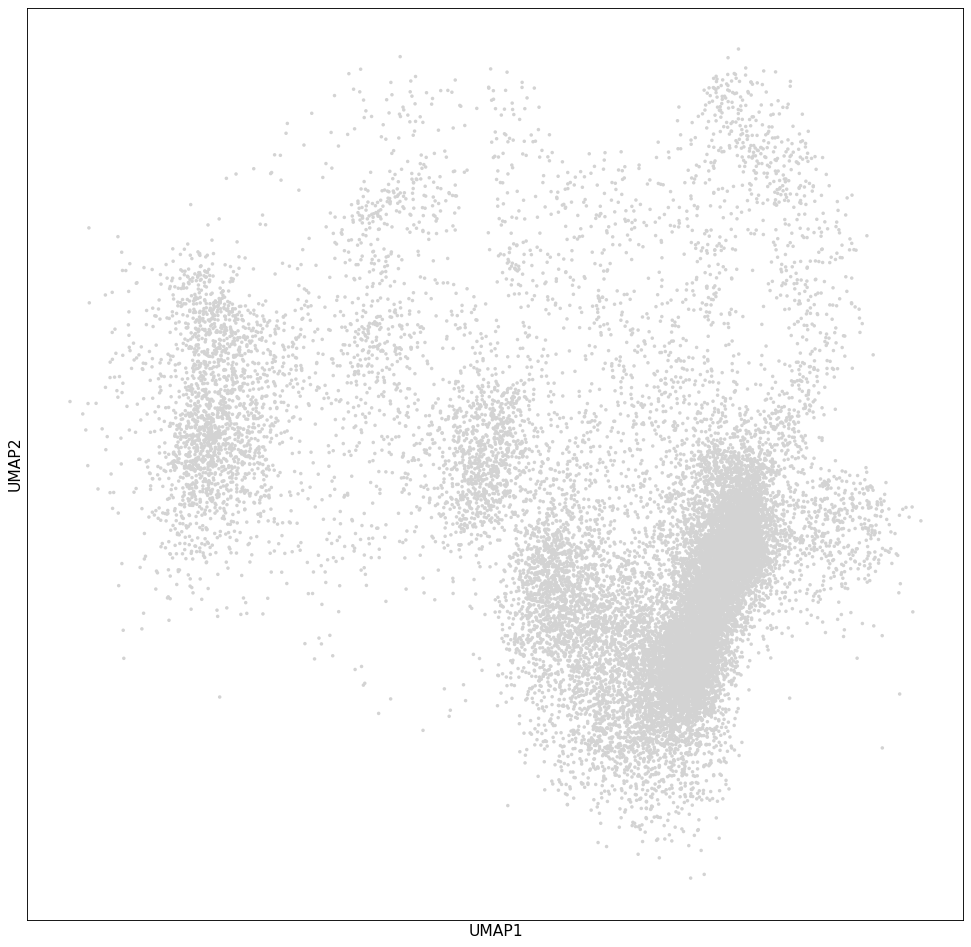

In [ ]:
sc.pl.umap(arabi_single_cell_slimmed_to_orthologs, wspace=0.5, s = 40)


In [ ]:
concatendated_arabi_maize_dataset = maize_single_cell_trimmed_to_orthologs.concatenate(arabi_single_cell_slimmed_to_orthologs, batch_key = 'Species', batch_categories = ['Maize','Arabidopsis'])

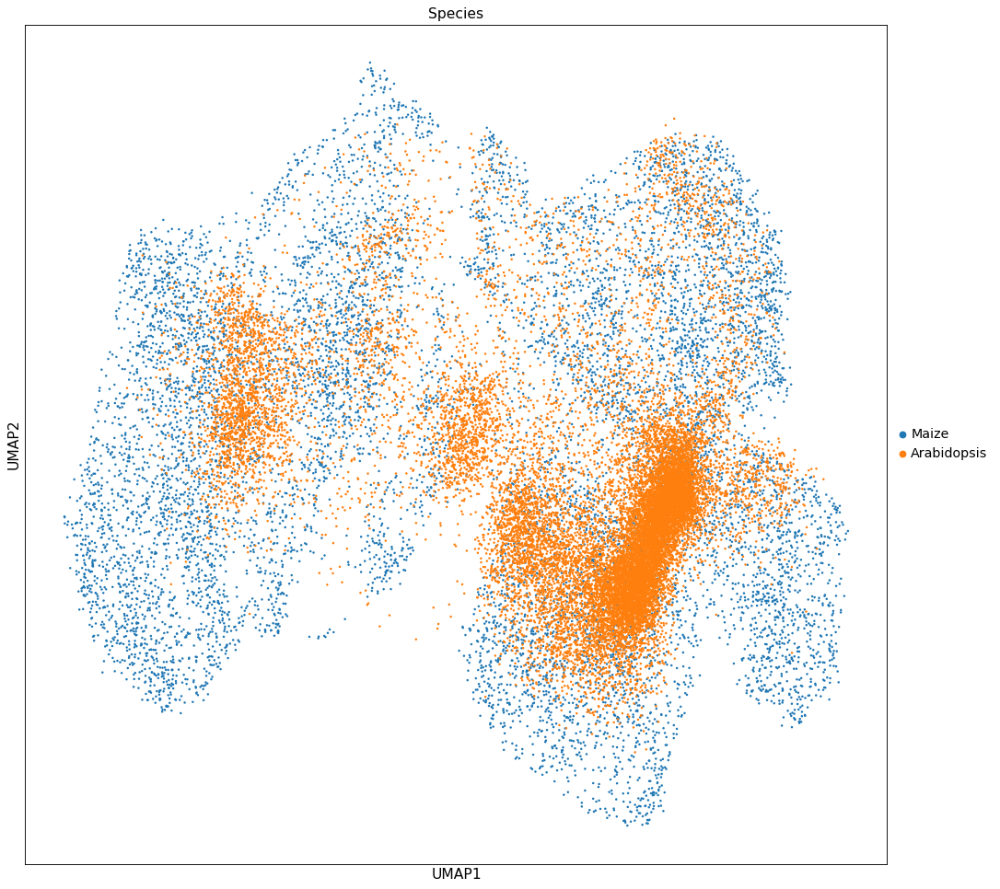

In [ ]:
sc.pl.umap(concatendated_arabi_maize_dataset, color='Species', s= 20, palette =['tab:blue','tab:orange'], save = "_maize_and_arabidopsis_all_cells_combined_and_mapped.png")


In [ ]:
concatendated_arabi_maize_dataset.obs.leiden = concatendated_arabi_maize_dataset.obs.leiden.astype('category')
concatendated_arabi_maize_dataset.obs.leiden.cat.reorder_categories(maize_single_cell_trimmed_to_orthologs.obs.leiden.cat.categories, inplace=True)  # fix category ordering
concatendated_arabi_maize_dataset.uns['leiden_colors'] = maize_single_cell_trimmed_to_orthologs.uns['leiden_colors']  # fix category colors




/tmp/ipykernel_2813768/1481419399.py:2: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  concatendated_arabi_maize_dataset.obs.leiden.cat.reorder_categories(maize_single_cell_trimmed_to_orthologs.obs.leiden.cat.categories, inplace=True)  # fix category ordering


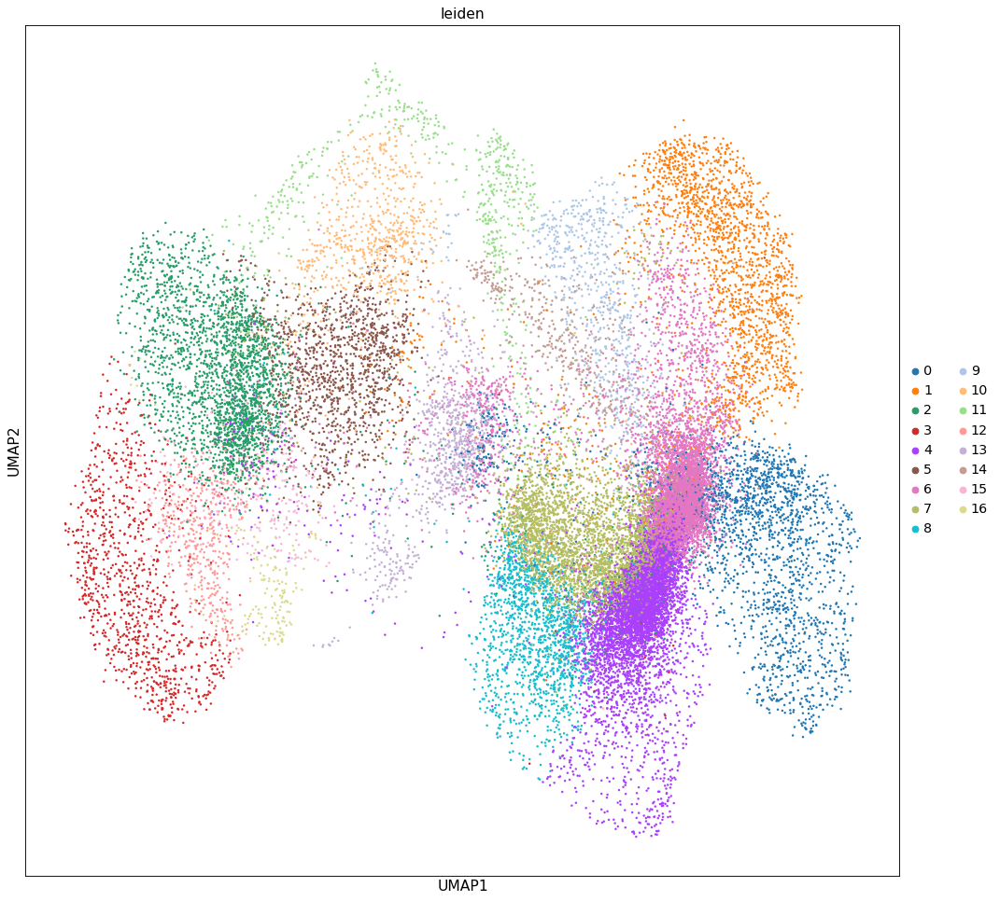

In [ ]:
sc.pl.umap(concatendated_arabi_maize_dataset, color='leiden', s= 20, save = '_maize_and_arabidopsis_all_cells_combined_with_cluster_color_labels.png')


In [ ]:
concatendated_arabi_maize_dataset.var['Gene'] = concatendated_arabi_maize_dataset.var_names
concatendated_arabi_maize_dataset.obs['CellID'] = concatendated_arabi_maize_dataset.obs_names

In [ ]:
concatendated_arabi_maize_dataset

AnnData object with n_obs × n_vars = 30775 × 4903
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1', 'leiden', 'percent.mt', 'RNA_snn_res.0.5', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54', 'Species', 'CellID'
    var: 'Arabidopsis Gene', 'GRM Name', 'features-Arabidopsis', 'features-Maize', 'highly_variable-Maize', 'means-Maize', 'dispersions-Maize', 'dispersions_norm-Maize', 'Gene'
    uns: 'Species_colors', 'leiden_colors'
    obsm: 'X_umap', 'X_pca'

In [ ]:
concatendated_arabi_maize_dataset.obs = concatendated_arabi_maize_dataset.obs[['nCount_RNA','seurat_clusters','nFeature_RNA','leiden','Species','DataSet','subcluster9']]

In [ ]:
concatendated_arabi_maize_dataset.raw = concatendated_arabi_maize_dataset

In [ ]:
concatendated_arabi_maize_dataset.raw.X

<30775x4903 sparse matrix of type '<class 'numpy.float32'>'
	with 41646558 stored elements in Compressed Sparse Row format>

In [ ]:
concatendated_arabi_maize_dataset.write('/home/passala/Gene_duplication_project/Code/Jack_Dave_maize_project/loom_files_for_jack/combined_arabidop_maize_as_h5ad_version_with_seurat.h5ad')

In [ ]:
arabi_single_cell

AnnData object with n_obs × n_vars = 20224 × 23339
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'RNA_snn_res.0.5', 'seurat_clusters', 'source', 'integrated_snn_res.0.5', 'integrated_snn_res.0.75', 'integrated_snn_res.1', 'integrated_snn_res.1.2', 'integrated_snn_res.1.5', 'integrated_snn_res.2', 'integrated_snn_res.0.45', 'integrated_snn_res.0.25', 'integrated_snn_res.0.7', 'integrated_snn_res.0.8', 'integrated_snn_res.0.65', 'integrated_snn_res.0.6', 'integrated_snn_res.0.55', 'integrated_snn_res.0.53', 'integrated_snn_res.0.52', 'integrated_snn_res.0.54'
    var: 'features', 'Arabidopsis Gene', 'GRM Name'
    obsm: 'X_umap'

In [ ]:
# arabi_single_cell.var['Gene'] = arabi_single_cell.var_names
# arabi_single_cell.obs['CellID'] = arabi_single_cell.obs_names

In [ ]:
arabi_single_cell.uns['leiden_colors'] = arabi_single_cell_slimmed_to_orthologs.uns['leiden_colors']
arabi_single_cell.obs['leiden'] = arabi_single_cell_slimmed_to_orthologs.obs['leiden']


In [ ]:
arabi_single_cell.obs = arabi_single_cell.obs[['nCount_RNA','seurat_clusters','nFeature_RNA','leiden']]

In [ ]:
arabi_single_cell.raw = arabi_single_cell

In [ ]:
#arabi_single_cell.write('/home/passala/Gene_duplication_project/Code/Jack_Dave_maize_project/loom_files_for_jack/just_arabidopsis_single_cell_with_leiden_and_seurat_clusters.h5ad')


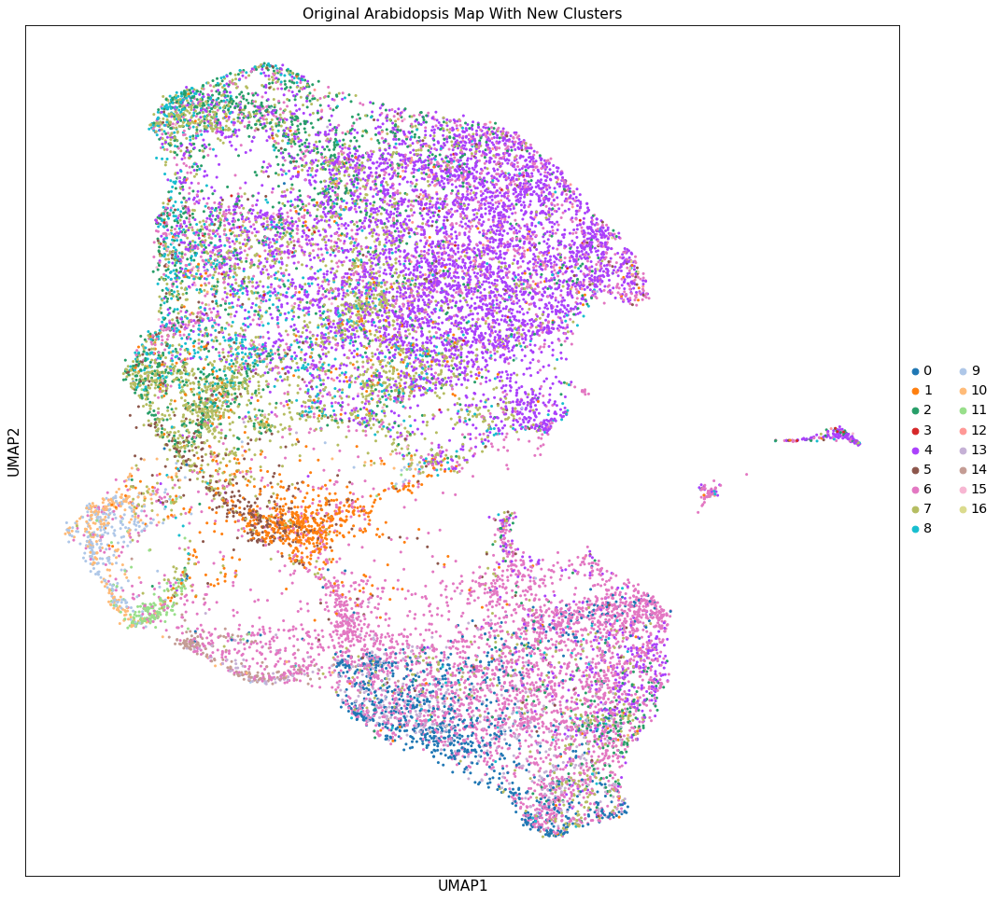

In [ ]:
sc.pl.umap(arabi_single_cell, color='leiden', s= 30, title = 'Original Arabidopsis Map With New Clusters')


In [ ]:
list_of_arabidopsis_groups = np.arange(0,17)
list_of_arabidopsis_groups = [str(x) for x in list_of_arabidopsis_groups]
list_of_arabidopsis_groups

['0',
 '1',
 '2',
 '3',
 '4',
 '5',
 '6',
 '7',
 '8',
 '9',
 '10',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16']

In [ ]:
maize_single_cell

AnnData object with n_obs × n_vars = 10551 × 28492
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'DataSet', 'integrated_snn_res.1', 'seurat_clusters', 'test_res.1', 'determinate', 'subcluster9', 'mygraph_res.1', 'leiden'
    var: 'features', 'Arabidopsis Gene', 'GRM Name'
    uns: 'leiden_colors'
    obsm: 'X_umap'

In [ ]:
maize_single_cell.obs = maize_single_cell.obs[['nCount_RNA','seurat_clusters','nFeature_RNA','leiden','DataSet','subcluster9']]

In [ ]:
maize_single_cell.raw = maize_single_cell

In [ ]:
maize_single_cell.write('/home/passala/Gene_duplication_project/Code/Jack_Dave_maize_project/loom_files_for_jack/just_maize_single_cell_with_leiden_and_seurat_clusters.h5ad')


/home/passala/miniconda3/envs/py39/lib/python3.9/site-packages/seaborn/matrix.py:1214: UserWarning: ``square=True`` ignored in clustermap
  warnings.warn(msg)


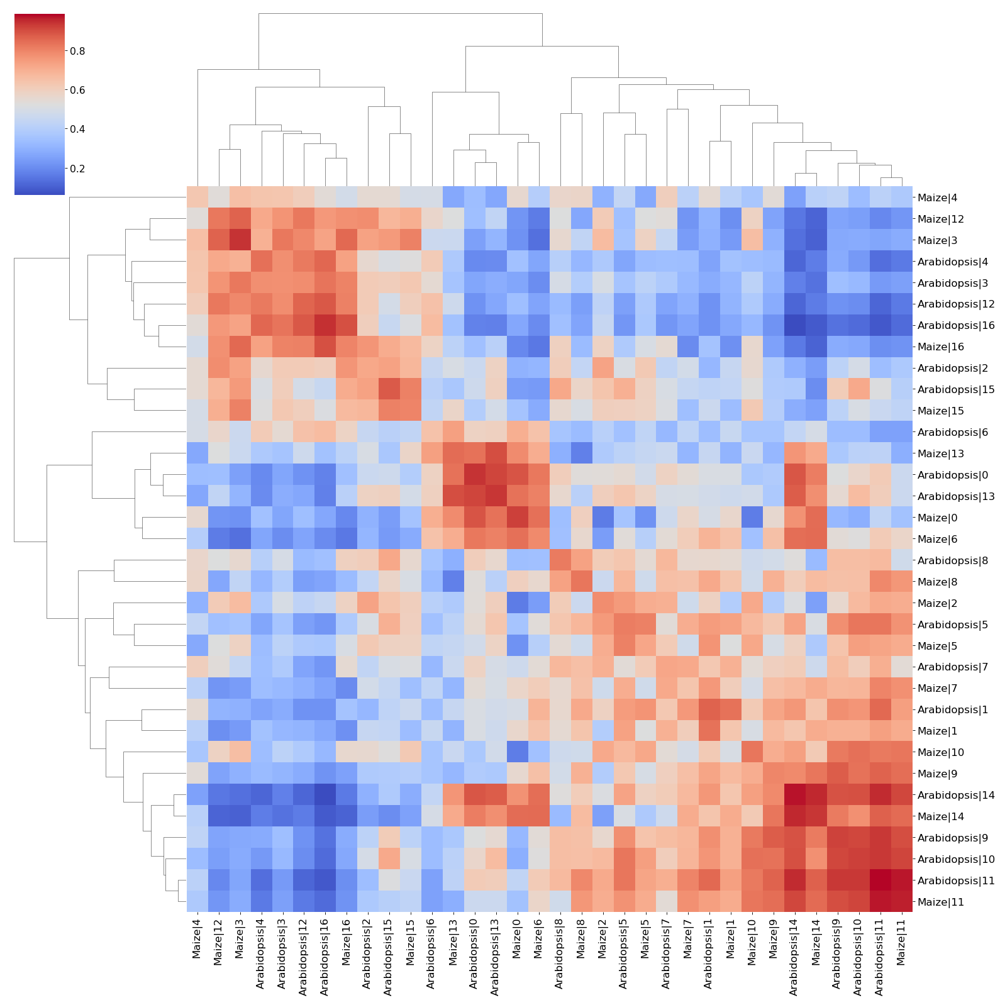

In [ ]:
pymn.variableGenes(concatendated_arabi_maize_dataset,study_col = 'Species')
pymn.MetaNeighborUS(concatendated_arabi_maize_dataset,study_col = 'Species',ct_col = 'leiden')
pymn.plotMetaNeighborUS(concatendated_arabi_maize_dataset,figsize = (20,20),cmap = 'coolwarm',fontsize = 15)

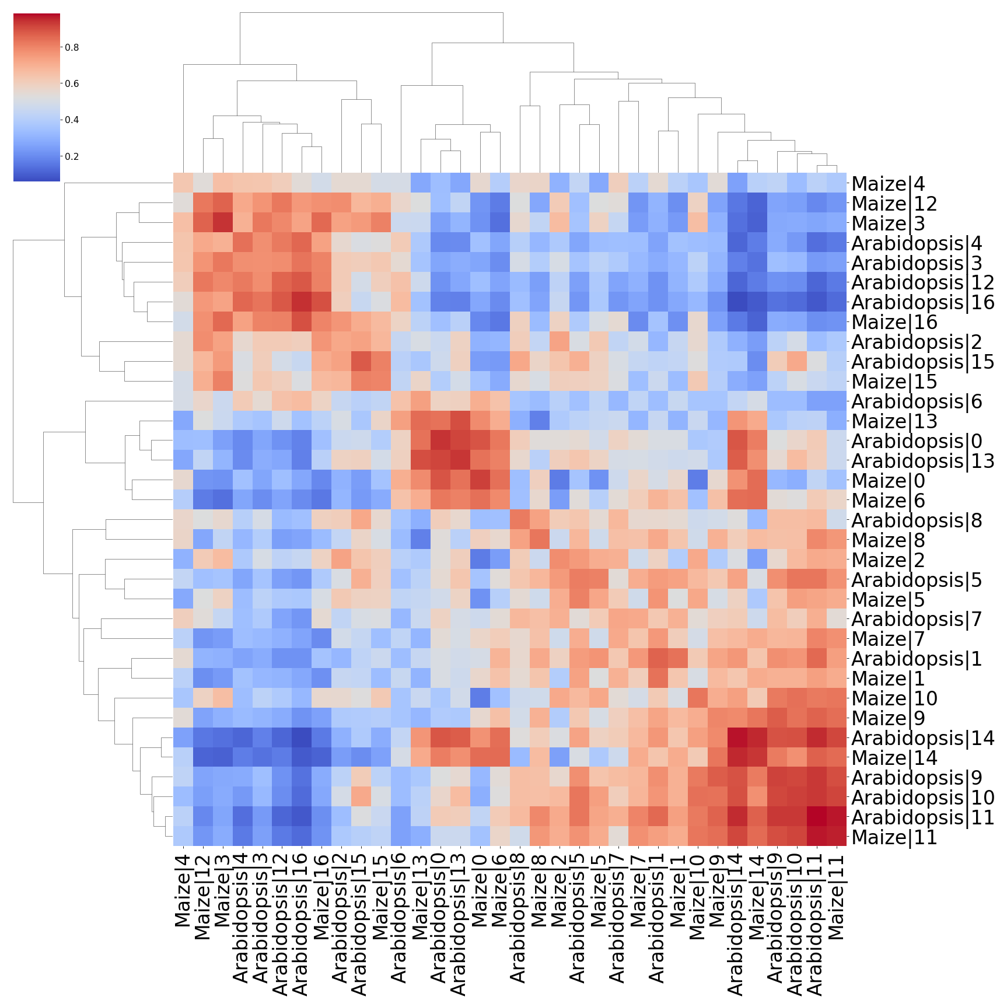

In [ ]:
pymn.plotMetaNeighborUS(concatendated_arabi_maize_dataset,figsize = (20,20),cmap = 'coolwarm',fontsize = 30)

In [ ]:
list_of_leiden_groups = np.arange(0,15,1)

In [ ]:
list_of_leiden_columns = []
for species in ['Maize','Arabidopsis']:
    for group in list_of_leiden_groups:
        current_group = f'{species} Cluster {group}'
        list_of_leiden_columns.append(current_group)
        

In [ ]:
list_of_leiden_columns

['Maize Cluster 0',
 'Maize Cluster 1',
 'Maize Cluster 2',
 'Maize Cluster 3',
 'Maize Cluster 4',
 'Maize Cluster 5',
 'Maize Cluster 6',
 'Maize Cluster 7',
 'Maize Cluster 8',
 'Maize Cluster 9',
 'Maize Cluster 10',
 'Maize Cluster 11',
 'Maize Cluster 12',
 'Maize Cluster 13',
 'Maize Cluster 14',
 'Arabidopsis Cluster 0',
 'Arabidopsis Cluster 1',
 'Arabidopsis Cluster 2',
 'Arabidopsis Cluster 3',
 'Arabidopsis Cluster 4',
 'Arabidopsis Cluster 5',
 'Arabidopsis Cluster 6',
 'Arabidopsis Cluster 7',
 'Arabidopsis Cluster 8',
 'Arabidopsis Cluster 9',
 'Arabidopsis Cluster 10',
 'Arabidopsis Cluster 11',
 'Arabidopsis Cluster 12',
 'Arabidopsis Cluster 13',
 'Arabidopsis Cluster 14']

In [ ]:
data_frame_of_centroid_results = pd.DataFrame(index = concatendated_arabi_maize_dataset.var_names, columns = list_of_leiden_columns)
data_frame_of_centroid_results

,Maize Cluster 0,Maize Cluster 1,Maize Cluster 2,Maize Cluster 3,Maize Cluster 4,Maize Cluster 5,Maize Cluster 6,Maize Cluster 7,Maize Cluster 8,Maize Cluster 9,...,Arabidopsis Cluster 5,Arabidopsis Cluster 6,Arabidopsis Cluster 7,Arabidopsis Cluster 8,Arabidopsis Cluster 9,Arabidopsis Cluster 10,Arabidopsis Cluster 11,Arabidopsis Cluster 12,Arabidopsis Cluster 13,Arabidopsis Cluster 14
AT1G01090,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AT1G01140,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AT1G01210,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AT1G01225,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AT1G01350,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AT1G44608,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AT2G18360,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AT2G20825,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AT2G30424,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
for group in list_of_leiden_groups:
    print(group)
    group = str(group)
    both_species_subset = concatendated_arabi_maize_dataset[concatendated_arabi_maize_dataset.obs['leiden'] == group]
    maize_subset = both_species_subset[both_species_subset.obs['Species'] == 'Maize']
    arabi_subset = both_species_subset[both_species_subset.obs['Species'] == 'Arabidopsis']
    current_maize = f'Maize Cluster {group}'
    data_frame_of_centroid_results[current_maize] = maize_subset.X.mean(axis = 0).tolist()[0]
    current_arab = f'Arabidopsis Cluster {group}'
    data_frame_of_centroid_results[current_arab] = arabi_subset.X.mean(axis = 0).tolist()[0]

    

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14


In [ ]:
maize_columns = []
for group in list_of_leiden_groups:
    current_group = f'Maize Cluster {group}'
    maize_columns.append(current_group)

In [ ]:
arabi_columns = []
for group in list_of_leiden_groups:
    current_group = f'Arabidopsis Cluster {group}'
    arabi_columns.append(current_group)

In [ ]:
arabi_columns

['Arabidopsis Cluster 0',
 'Arabidopsis Cluster 1',
 'Arabidopsis Cluster 2',
 'Arabidopsis Cluster 3',
 'Arabidopsis Cluster 4',
 'Arabidopsis Cluster 5',
 'Arabidopsis Cluster 6',
 'Arabidopsis Cluster 7',
 'Arabidopsis Cluster 8',
 'Arabidopsis Cluster 9',
 'Arabidopsis Cluster 10',
 'Arabidopsis Cluster 11',
 'Arabidopsis Cluster 12',
 'Arabidopsis Cluster 13',
 'Arabidopsis Cluster 14']

In [ ]:
len(maize_subset.X.mean(axis = 1))

304

In [ ]:
combo_list = list(itertools.product(maize_columns, arabi_columns))


In [ ]:
results_for_heat_map = pd.DataFrame(index = maize_columns, columns = arabi_columns)
results_for_heat_map

,Arabidopsis Cluster 0,Arabidopsis Cluster 1,Arabidopsis Cluster 2,Arabidopsis Cluster 3,Arabidopsis Cluster 4,Arabidopsis Cluster 5,Arabidopsis Cluster 6,Arabidopsis Cluster 7,Arabidopsis Cluster 8,Arabidopsis Cluster 9,Arabidopsis Cluster 10,Arabidopsis Cluster 11,Arabidopsis Cluster 12,Arabidopsis Cluster 13,Arabidopsis Cluster 14
Maize Cluster 0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Maize Cluster 9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
data_frame_of_centroid_results

,Maize Cluster 0,Maize Cluster 1,Maize Cluster 2,Maize Cluster 3,Maize Cluster 4,Maize Cluster 5,Maize Cluster 6,Maize Cluster 7,Maize Cluster 8,Maize Cluster 9,...,Arabidopsis Cluster 5,Arabidopsis Cluster 6,Arabidopsis Cluster 7,Arabidopsis Cluster 8,Arabidopsis Cluster 9,Arabidopsis Cluster 10,Arabidopsis Cluster 11,Arabidopsis Cluster 12,Arabidopsis Cluster 13,Arabidopsis Cluster 14
AT1G01090,0.565863,0.416928,0.613562,0.452458,0.484393,0.553962,0.486518,0.567834,0.547551,0.537689,...,0.559232,0.377523,0.265129,0.321744,0.390761,0.609066,0.436528,0.250197,0.481031,0.427295
AT1G01140,0.087873,0.052121,0.061512,0.102834,0.151088,0.049185,0.058079,0.062319,0.054355,0.055568,...,0.901883,0.881925,0.579494,0.819414,0.909317,0.972093,0.490811,0.934360,0.885296,0.822364
AT1G01210,0.178511,0.239306,0.255853,0.160000,0.243120,0.232389,0.237351,0.284907,0.240154,0.352670,...,0.078637,0.059842,0.055858,0.064075,0.051481,0.069732,0.104107,0.056242,0.049918,0.100734
AT1G01225,0.025129,0.008320,0.008065,0.004394,0.022257,0.003094,0.014388,0.008660,0.043099,0.015294,...,0.054865,0.041765,0.042591,0.048452,0.051463,0.096797,0.182333,0.005690,0.080756,0.076943
AT1G01350,0.242763,0.239209,0.221076,0.101172,0.218460,0.169449,0.223671,0.337097,0.276663,0.300603,...,0.343749,0.304195,0.209504,0.152579,0.332772,0.388463,0.288287,0.156570,0.273526,0.293248
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AT1G44608,0.006101,0.004535,0.004882,0.002105,0.017719,0.002747,0.003329,0.003555,0.012820,0.004640,...,0.000000,0.000000,0.000000,0.000516,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AT2G18360,0.006554,0.000559,0.000000,0.000000,0.000735,0.000000,0.005975,0.000000,0.002729,0.000532,...,0.001816,0.000000,0.000156,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AT2G20825,0.145561,0.071961,0.145155,0.214655,0.138579,0.119857,0.078289,0.087074,0.218740,0.123424,...,0.001601,0.000077,0.000000,0.000000,0.000000,0.000000,0.003673,0.000000,0.000000,0.000000
AT2G30424,0.000331,0.000194,0.000000,0.001465,0.000629,0.000442,0.000485,0.000175,0.000000,0.002081,...,0.000000,0.000230,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001432,0.000000


In [ ]:
for combo in combo_list:
    maize_column = combo[0]
    arabidop_column = combo[1]
    maize_gene_results = data_frame_of_centroid_results[maize_column]
    arabidop_gene_results = data_frame_of_centroid_results[arabidop_column]
    correlation_result = maize_gene_results.corr(arabidop_gene_results, method = 'spearman')
    results_for_heat_map.at[maize_column,arabidop_column] = correlation_result
    


In [ ]:
results_for_heat_map

,Arabidopsis Cluster 0,Arabidopsis Cluster 1,Arabidopsis Cluster 2,Arabidopsis Cluster 3,Arabidopsis Cluster 4,Arabidopsis Cluster 5,Arabidopsis Cluster 6,Arabidopsis Cluster 7,Arabidopsis Cluster 8,Arabidopsis Cluster 9,Arabidopsis Cluster 10,Arabidopsis Cluster 11,Arabidopsis Cluster 12,Arabidopsis Cluster 13,Arabidopsis Cluster 14
Maize Cluster 0,0.521466,0.526965,0.480953,0.424688,0.450595,0.531962,0.503318,0.507626,0.468786,0.499888,0.508952,0.512588,0.411029,0.512635,0.51521
Maize Cluster 1,0.488186,0.553302,0.461407,0.398091,0.422313,0.549808,0.481438,0.508769,0.452376,0.53962,0.546245,0.544035,0.375402,0.494632,0.531
Maize Cluster 2,0.481033,0.507821,0.474094,0.40845,0.430175,0.528585,0.466674,0.489616,0.45078,0.484533,0.501919,0.501252,0.394313,0.481707,0.47785
Maize Cluster 3,0.475291,0.478549,0.47827,0.449039,0.464938,0.493137,0.475689,0.474384,0.472177,0.471764,0.477486,0.472116,0.440529,0.471119,0.456038
Maize Cluster 4,0.522911,0.549507,0.510849,0.470626,0.492682,0.546563,0.518231,0.537198,0.512706,0.522139,0.521717,0.530821,0.449691,0.507471,0.509646
Maize Cluster 5,0.458904,0.508011,0.446398,0.379853,0.401124,0.526164,0.451267,0.470558,0.42168,0.49549,0.514132,0.499282,0.365519,0.472927,0.485981
Maize Cluster 6,0.492824,0.532664,0.449488,0.386672,0.411306,0.530826,0.482437,0.491567,0.434762,0.523543,0.533401,0.529653,0.369314,0.50158,0.536318
Maize Cluster 7,0.507493,0.554629,0.478733,0.410409,0.433009,0.555915,0.491169,0.523945,0.469495,0.533725,0.542287,0.555165,0.38421,0.506099,0.533581
Maize Cluster 8,0.510234,0.541853,0.490065,0.430902,0.452217,0.54514,0.490105,0.523233,0.497144,0.518864,0.522845,0.545176,0.402653,0.496745,0.511988
Maize Cluster 9,0.468815,0.537517,0.443857,0.392986,0.413434,0.523615,0.472365,0.48753,0.443419,0.568026,0.570295,0.578686,0.368032,0.485866,0.562293
